<a href="https://colab.research.google.com/github/IsabellaGarciaS/Biosignals/blob/main/CorreccionProyecto1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<head><p><img alt="udeA logo" height="150px" src="https://github.com/freddyduitama/images/blob/master/logo.png?raw=true" align="left" hspace="50px" vspace="0px" style="width:107px;height:152px;"></p>
<h1><font color='black'> <center>
       Bioseñales y Sistemas </center></font></h1>
<p3><center><b><font color='black' face="Lucida Calligraphy,Comic Sans MS,Lucida Console" size="5">Universidad de Antioquia</font></b> </center></p3>
</font>
<h2><font color='black'> <center>
Proyecto 1 - Corrección</center></font></h2>
<h3><font color='black'> <center>
Danna Isabella Garcia Saenz - Solanlly Evenedy Montoya Rivera </center></font></h3>
<font  face="Courier New" size="3">
<p1><center> </center></p1></head>


In [ ]:
#Instalo las librerias necesarias
from scipy.io import loadmat
import scipy.io as sio
import matplotlib.pyplot as plt
import numpy as np
from csv import reader as reader_csv;
import scipy.signal as signal;
import pandas as pd
import glob
import math
import os
from scipy.stats import linregress
from scipy.signal import find_peaks
from scipy.stats import kstest
from scipy.stats import levene
from scipy.stats import mannwhitneyu
import seaborn as sns


from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#direccion de la ruta de la carpeta principal de datos
carpeta_principal= "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"

#obtenemos la lista de directorios en la carpeta
directorios= [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]

listas_sujetos= [] #creamos una lista con los sujetos
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto= os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

#imprimimos las listas para verificar
for i, lista in enumerate(listas_sujetos, 1):
    print(f"sujeto{i}: {lista}")

sujeto1: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/01
sujeto2: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/02
sujeto3: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/03
sujeto4: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/04
sujeto5: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/05
sujeto6: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/06
sujeto7: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/07
sujeto8: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/08
sujeto9: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/09
sujeto10: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/10
sujeto11: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/11
sujeto12: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_

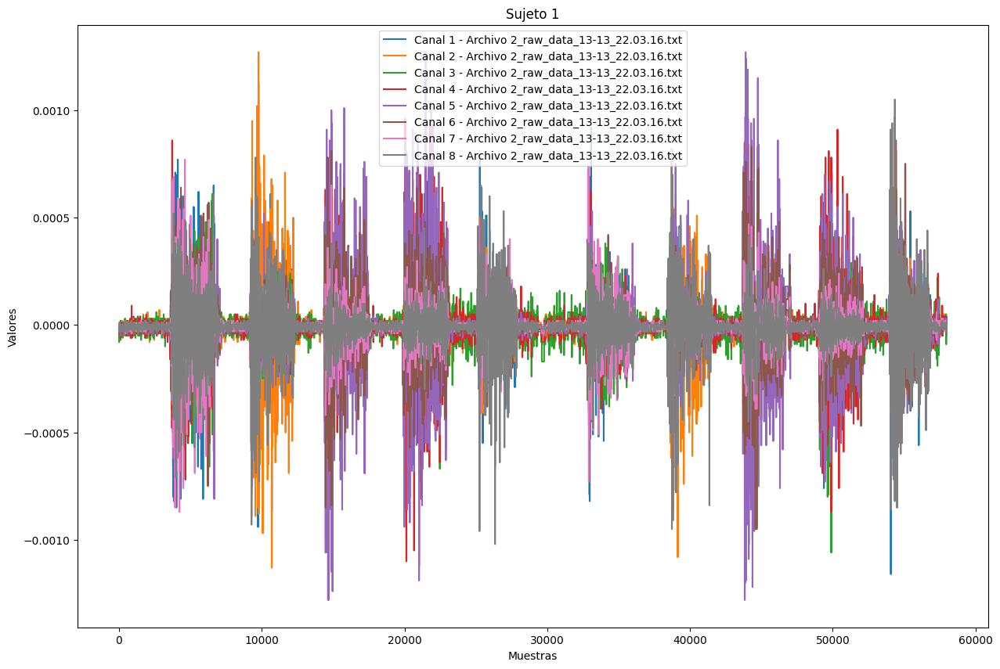

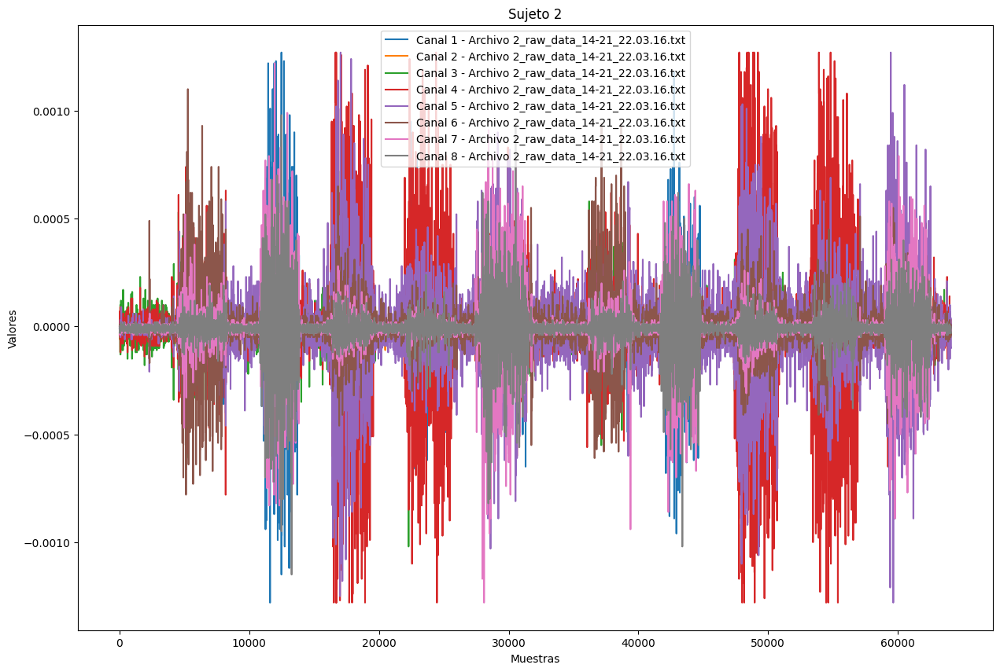

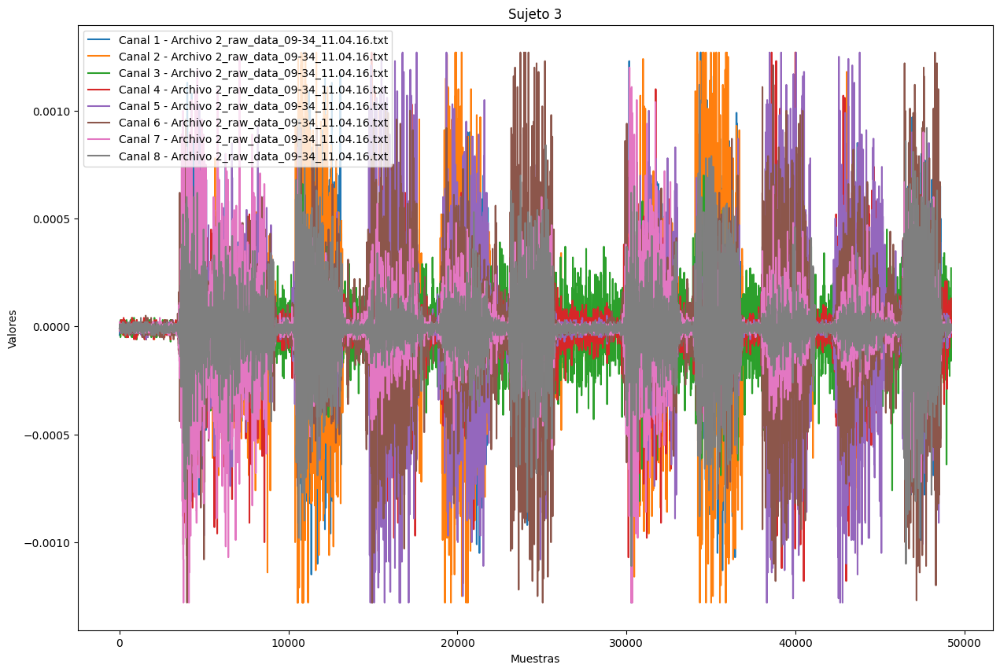

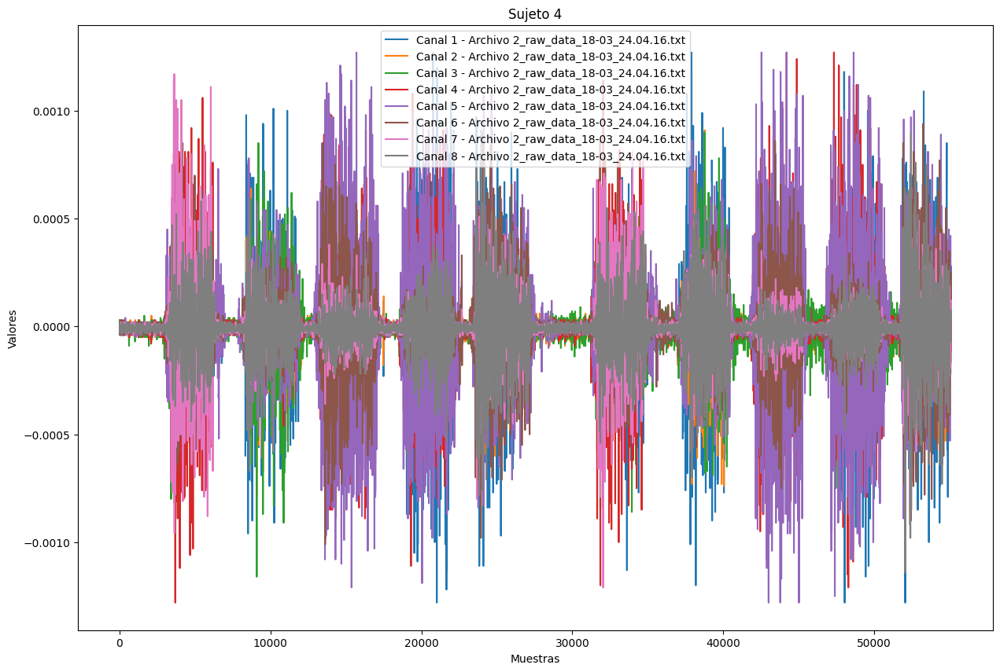

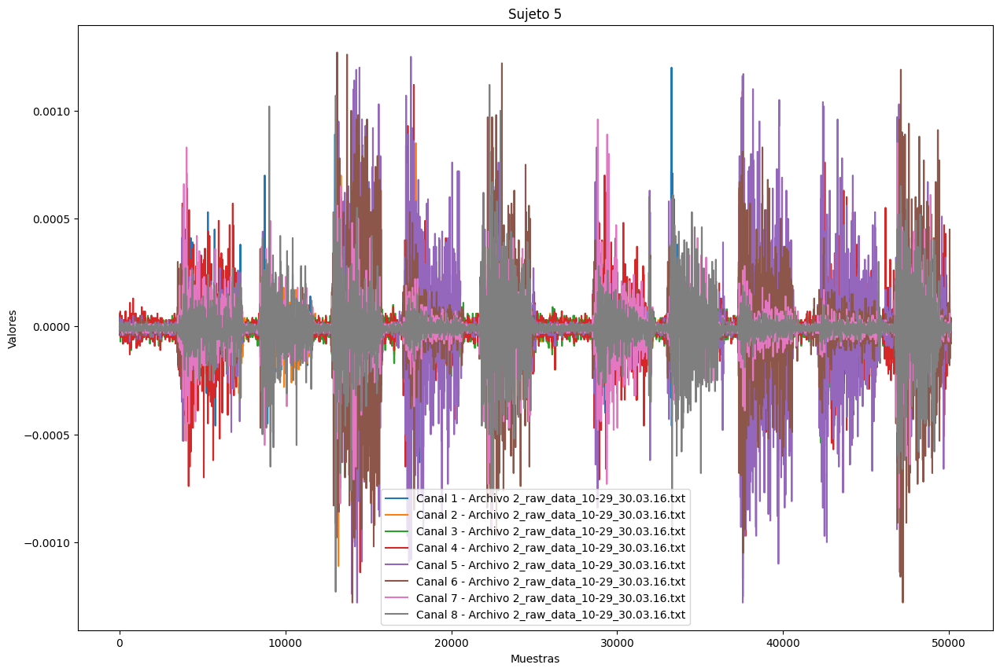

...

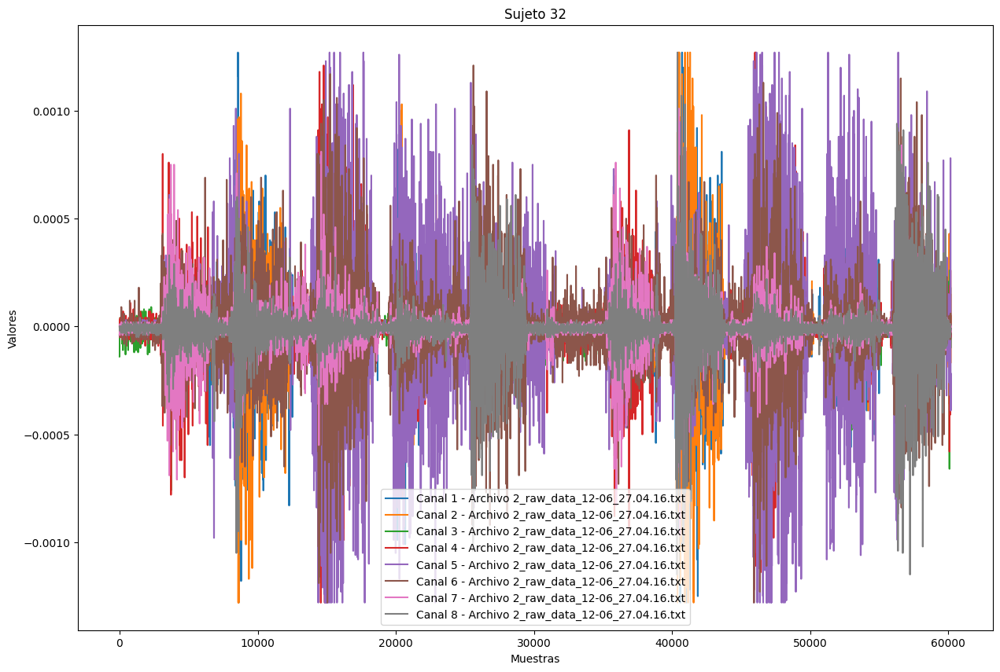

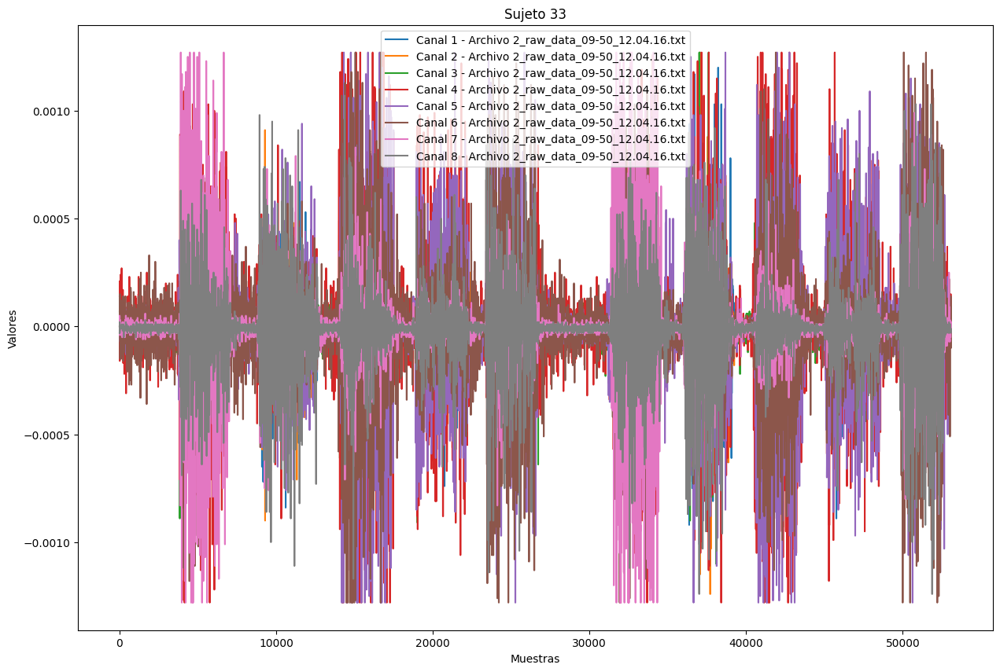

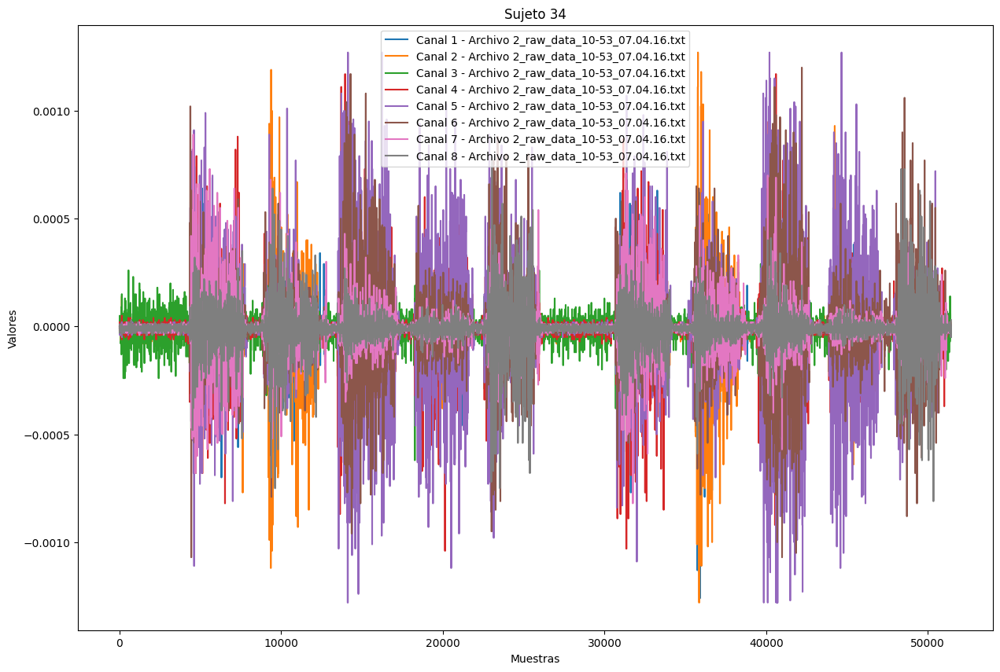

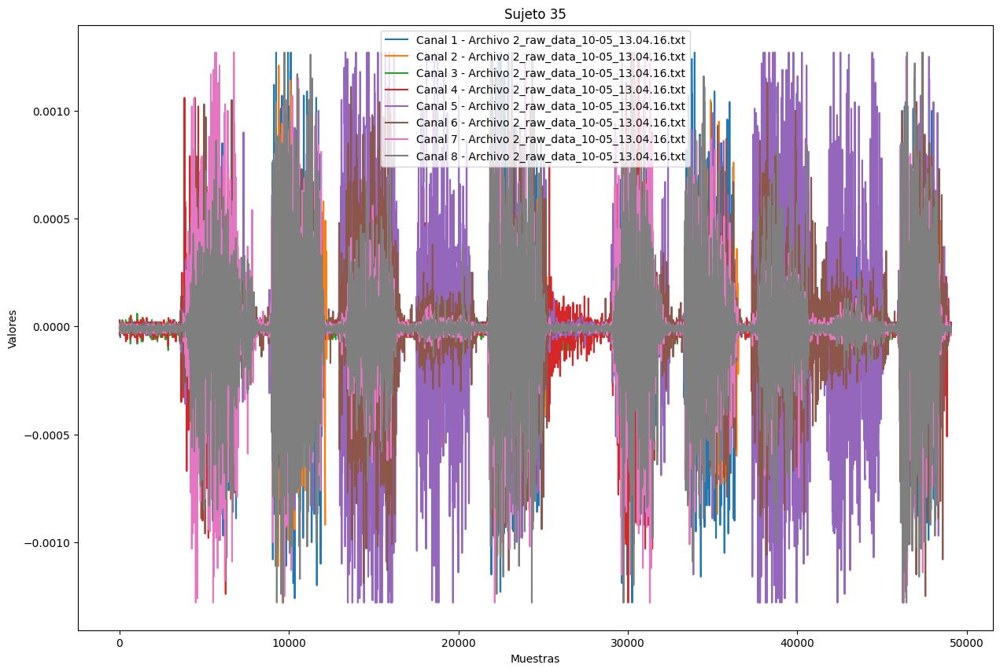

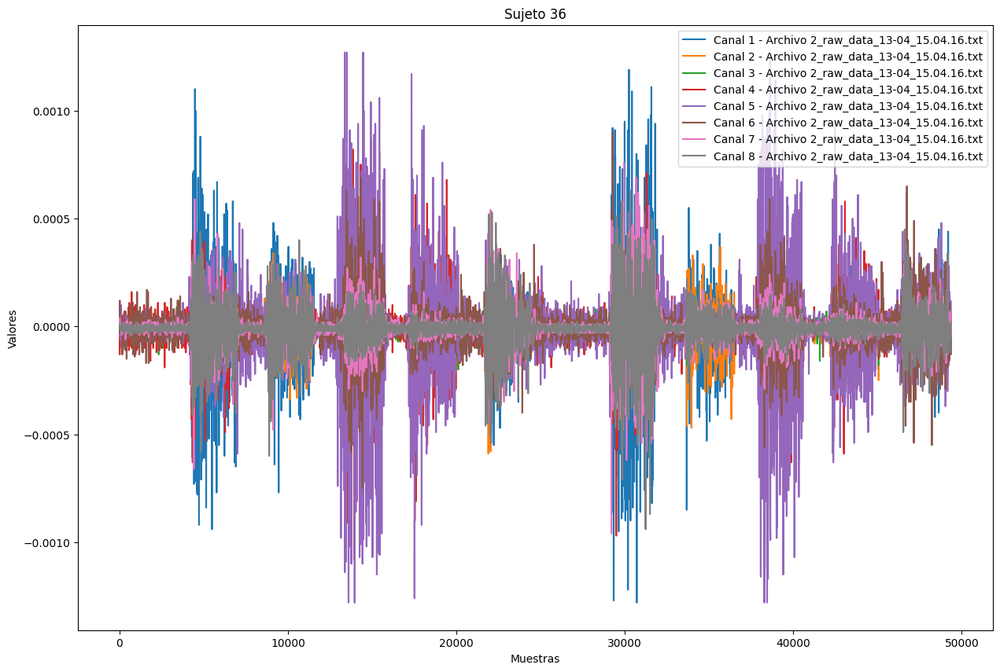

In [ ]:
#este codigo es para leer y grafica los datos de las señales .txt,  las organiza por canales y los grafica en una figura para cada sujeto de los 36

for i, lista in enumerate(listas_sujetos, 1):  #itera sobre los diferentes sujetos de la lista
    archivos_txt = glob.glob(os.path.join(lista, "2*.txt")) #busca el patron que conincida con 1 porque estos archivos son los que tienen el EMG

    #para leer y graficar archivos .txt
    plt.figure(figsize=(15, 10))  # Tamaño de la figura
    for archivo in archivos_txt:
        datos= []
        with open(archivo, 'r') as file:
            next(file)  #salta la primera línea porque aqui hay es titulos
            for linea in file:
                valores= [float(valor) for valor in linea.strip().split('\t')[1:9]]  #obtenemos los valores de canales 1 a 8
                datos.append(valores)

        datos_transpuestos= list(zip(*datos))  #transponer datos para facilitar la graficación
        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            plt.plot(valores_canal, label=f"Canal {canal} - Archivo {os.path.basename(archivo)}") #grafica cada canal

    plt.title(f"Sujeto {i}")
    plt.ylabel("Valores")
    plt.xlabel("Muestras")
    plt.legend()
    plt.show()

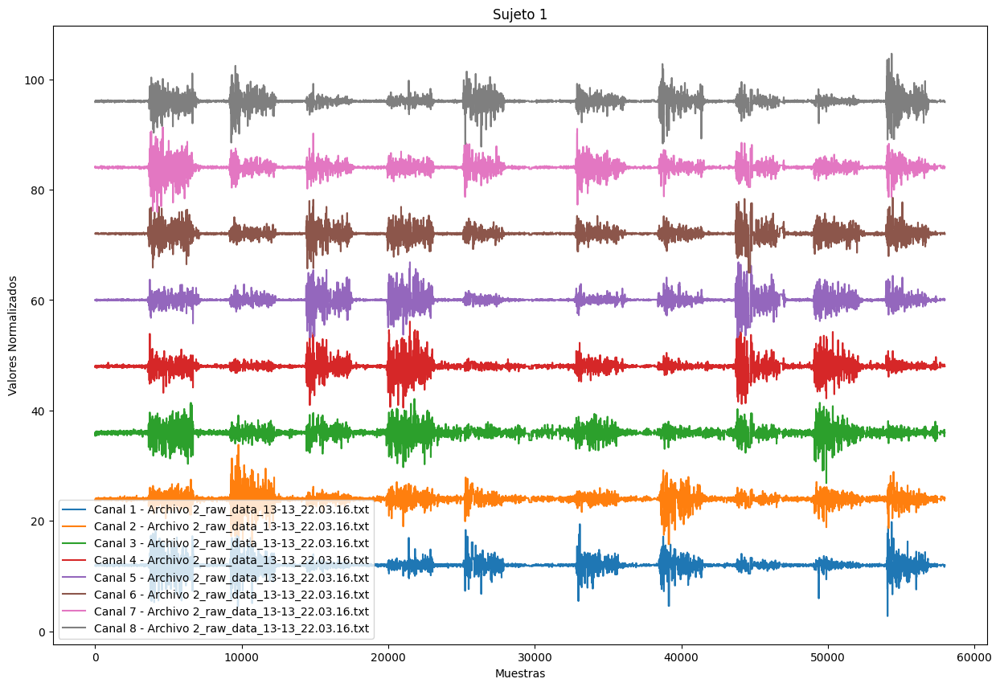

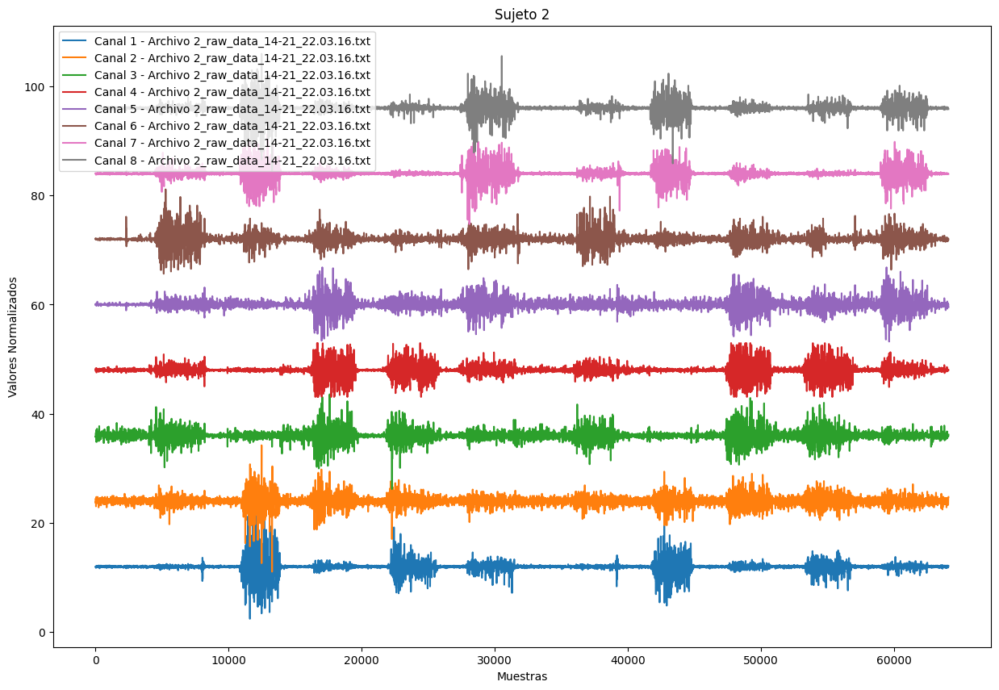

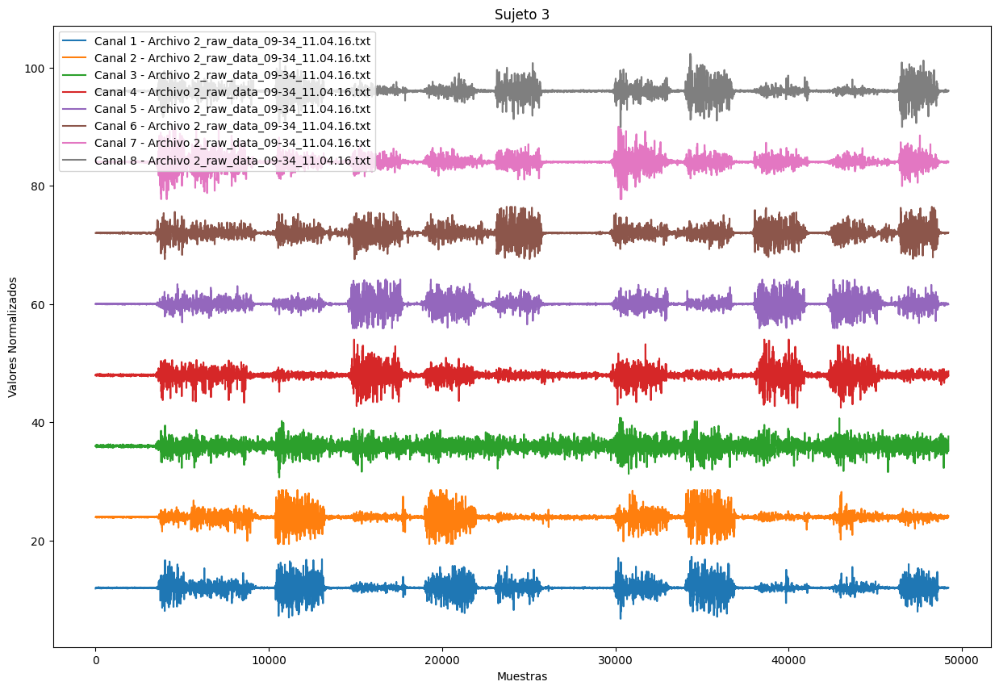

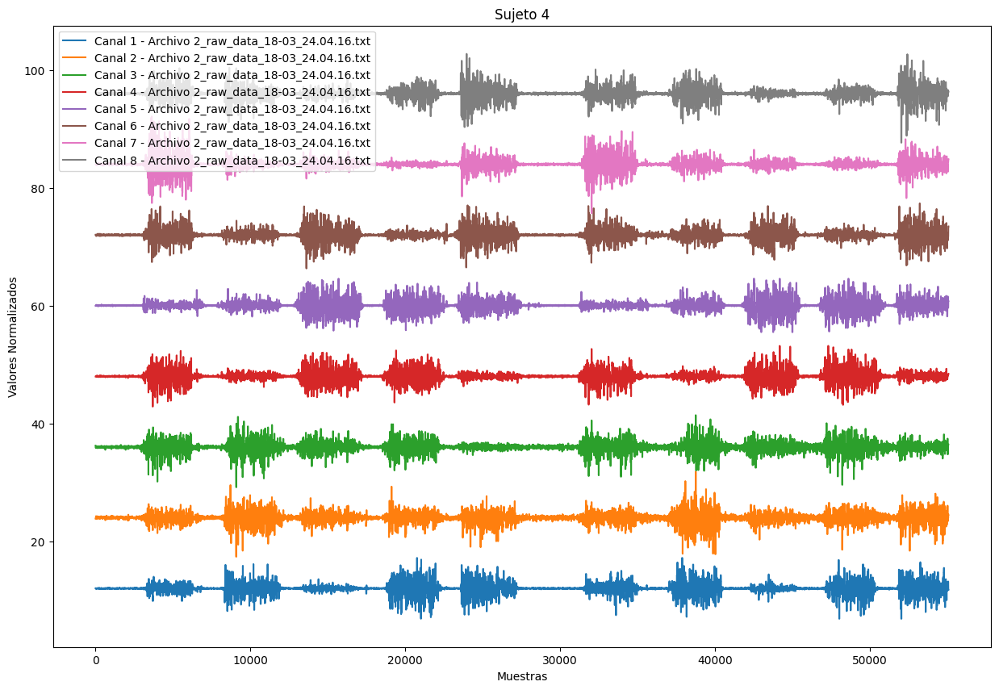

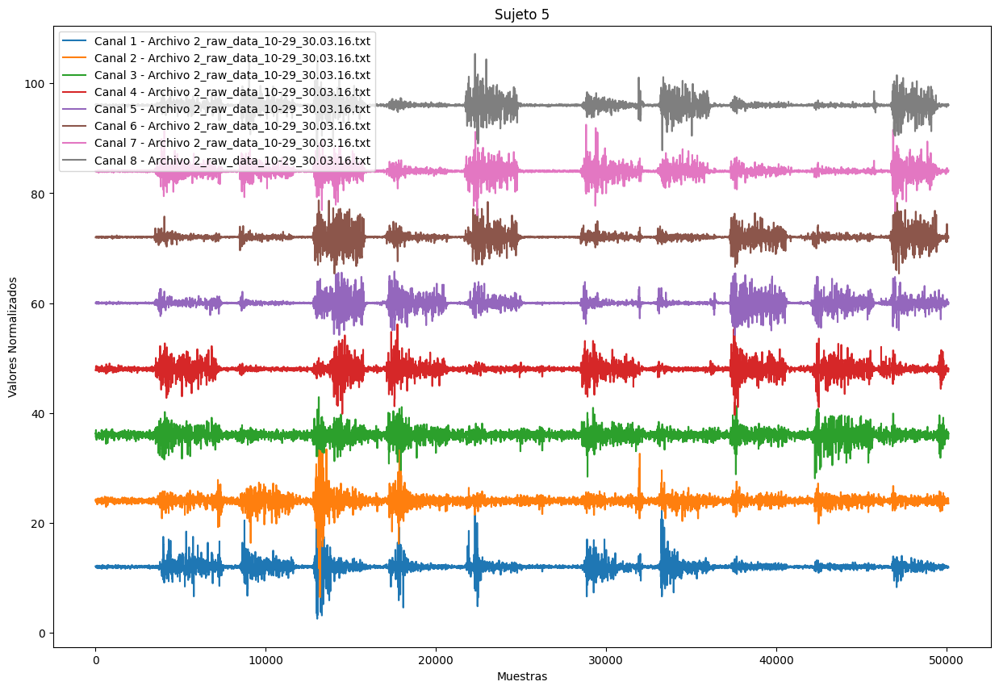

...

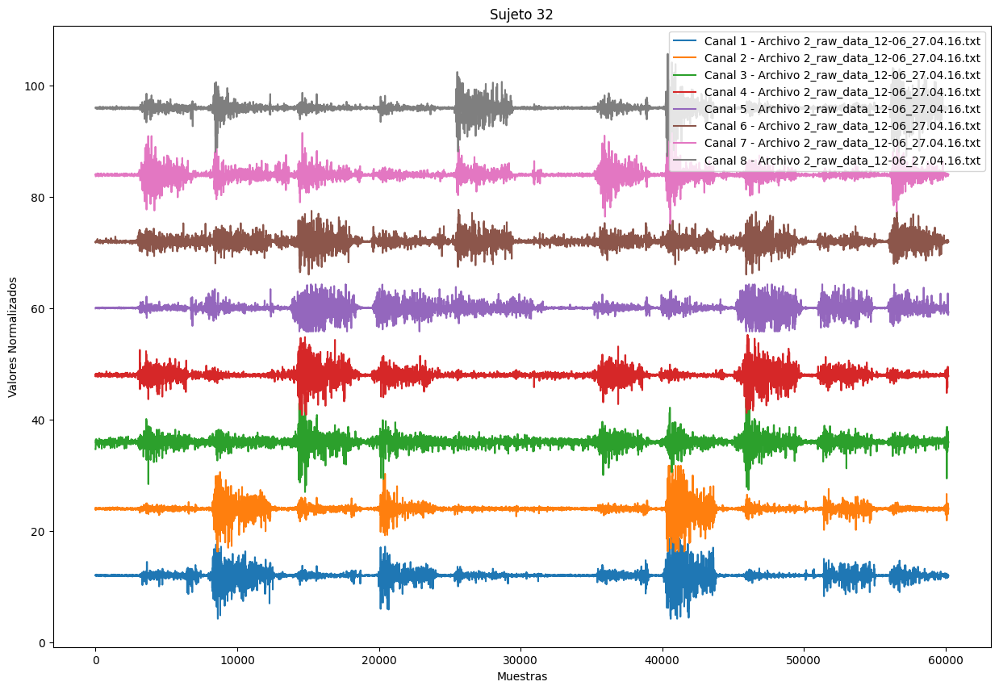

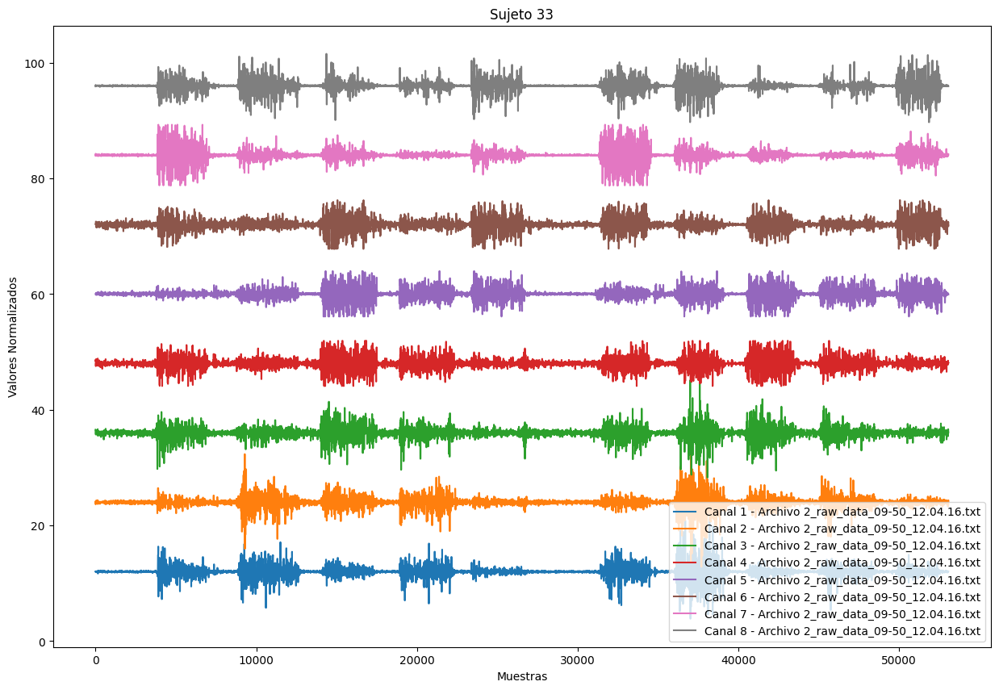

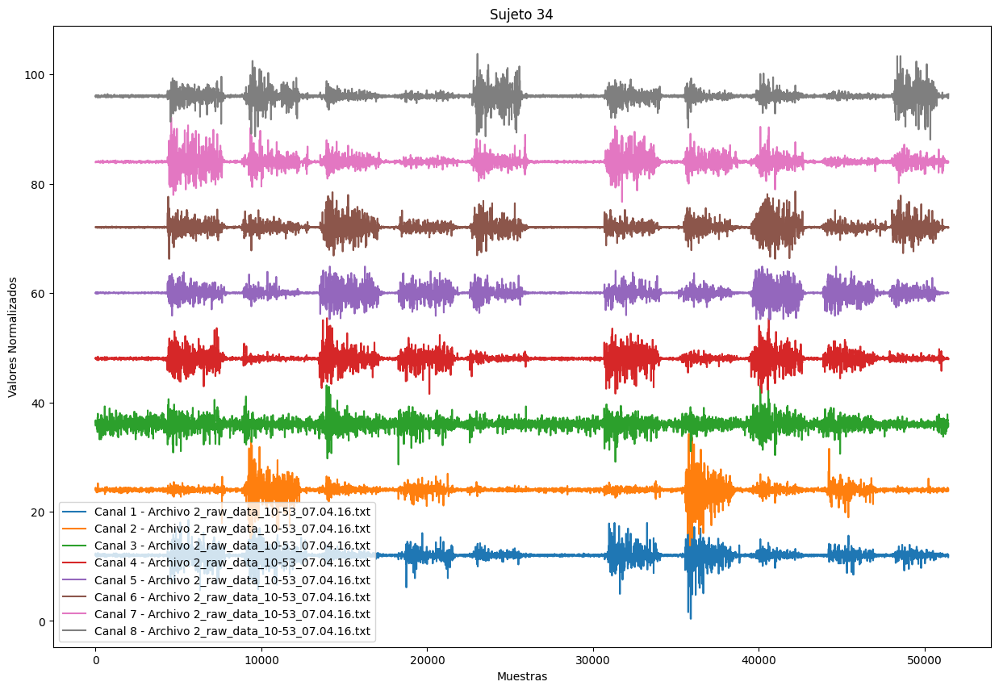

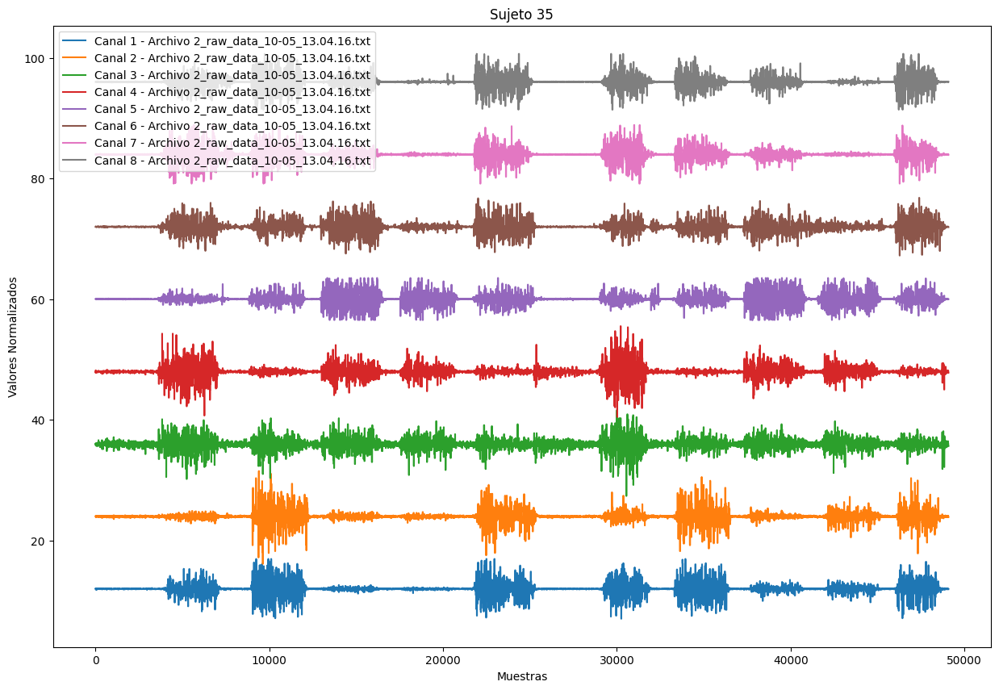

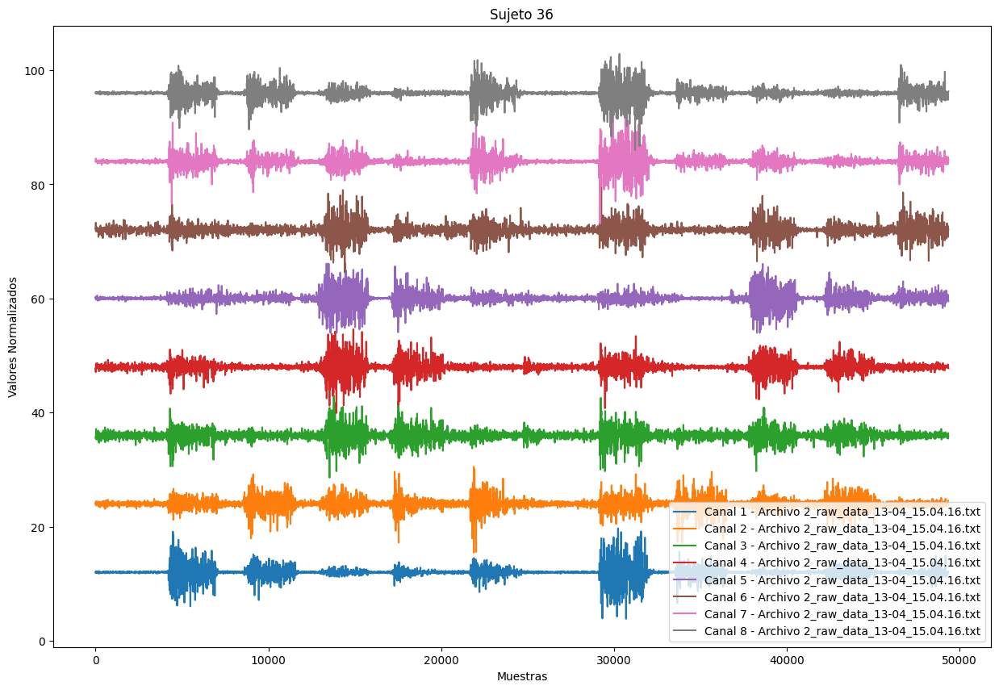

In [ ]:
#graficamos y normalizar los datos de los archivos que comienzan con (2) como por ejemplo 2_raw_data_12-12_25.04.16.txt

for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt= glob.glob(os.path.join(lista, "2*.txt"))

    plt.figure(figsize=(15, 10))
    for archivo in archivos_txt:
        datos= []
        with open(archivo, 'r') as file:
            next(file)  #saltamos la primera fila para evitar errores por los titulos
            for linea in file:
                valores= [float(valor) for valor in linea.strip().split('\t')[1:9]]  #valores de los canales 1 a 8
                datos.append(valores)
        datos_transpuestos= np.array(list(zip(*datos)))  #transposicion de los datos

        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            valores_canal= (valores_canal - np.mean(valores_canal)) / np.std(valores_canal)  #normalizacion
            offset= canal * 12  #offset
            plt.plot(valores_canal + offset, label=f"Canal {canal} - Archivo {os.path.basename(archivo)}")

    plt.title(f"Sujeto {i}")
    plt.xlabel("Muestras")
    plt.ylabel("Valores Normalizados")
    plt.legend()
    plt.show()

**1. Crear una función que reciba la señal de EMG y permita aplicar el operador**
---

Teager-Kaiser Energy Operator (TKEO). (10 %)

*La correccion que nos sugirio la profe fue la siguiente: Revisar el operador tkeo, pues las amplitudes son muy grandes*

Que le modificamos al codigo: antes de aplicar el operado, se normalizo la señal dividiendo por el valor máximo absoluto, el operador TKEO sirve para resaltar características no lineales de nuestros datos, anteriormente cometimos el error de cambiarle la escala al codigo utilizando un comando para agrandarlo, pero se le elimino para poder apreciar la señal como verdaderamente se grafica

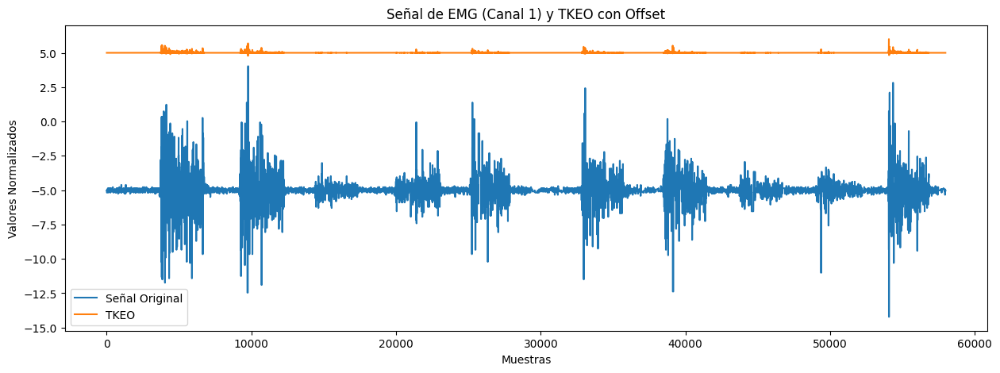

In [ ]:
def tkeo_operator(emg_signal):
    emg_signal = np.array(emg_signal)
    emg_signal_normalized = emg_signal / np.max(np.abs(emg_signal)) #normalizar la señal EMG antes de aplicar TKEO
    tkeo_result = emg_signal_normalized[1:-1] ** 2 - emg_signal_normalized[:-2] * emg_signal_normalized[2:]
    tkeo_result_normalized = tkeo_result / np.max(np.abs(tkeo_result)) #normalizar la señal TKEO después de aplicarla

    tkeo_result_scaled = tkeo_result_normalized #aplicar un factor de escala a la señal TKEO normalizada
    return tkeo_result_scaled

sujeto_ejemplo = listas_sujetos[0]
archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
archivo_canal_ejemplo = archivos_txt_ejemplo[0]

datos_canal_original = []
with open(archivo_canal_ejemplo, 'r') as file:
    next(file)
    for linea in file:
        valores = [float(valor) for valor in linea.strip().split('\t')[1:2]]
        datos_canal_original.append(valores[0])

datos_canal_original = (datos_canal_original - np.mean(datos_canal_original)) / np.std(datos_canal_original)

tkeo_result = tkeo_operator(datos_canal_original)

offset = -5
plt.figure(figsize=(15, 5))
plt.plot(datos_canal_original + offset, label='Señal Original')
plt.plot(tkeo_result - offset, label='TKEO')
plt.legend()
plt.title('Señal de EMG (Canal 1) y TKEO con Offset')
plt.xlabel('Muestras')
plt.ylabel('Valores Normalizados')
plt.show()

En el gráfico, se puede observar que la señal TKEO (línea naranja) resalta los picos y cambios rápidos en la señal de EMG original, el TKEO enfatiza los momentos de mayor actividad muscular, lo que puede ser útil para la segmentación de gestos en el análisis de señales de EMG. La señal TKEO tiene amplitudes más pequeñas que la señal original de EMG debido a la forma en que el operador TKEO funciona, este calcula la energía de la señal con valores siempre positivos, esto es diferente de la señal original, que puede tener tanto valores positivos como negativos

**2. Crear una función que reciba una señal EMG de múltiples canales y calcule el operador TKEO para cada canal**
--

*La correccion que nos sugirio la profe fue la siguiente: No se realiza sobre cada uno de los gestos*

Que le modificamos al codigo: aplicamos ciclos for para que para los 36 sujetos se vean graficas para cada gesto, por lo tanto el gesto 1 va a mostrar sus 8 canales donde podemos ver como se comporta la señal y si hay similitudes mas facilmente, a simple vista podemos observar que los canales tienen muchos picos en comun para sus diferentes gestos

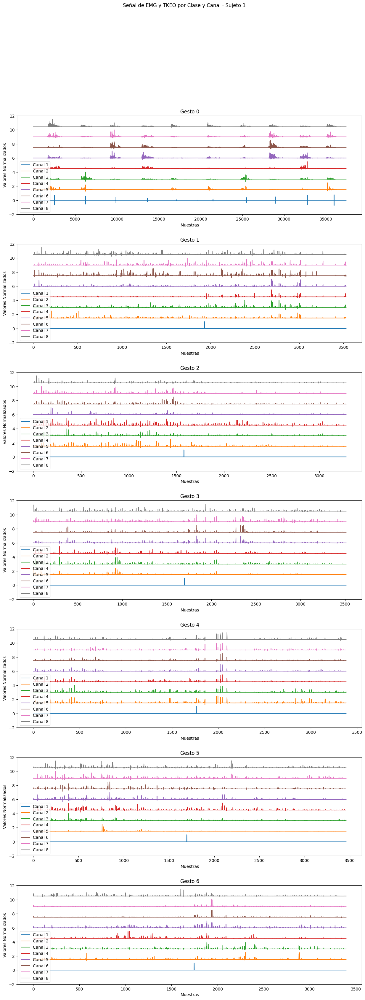

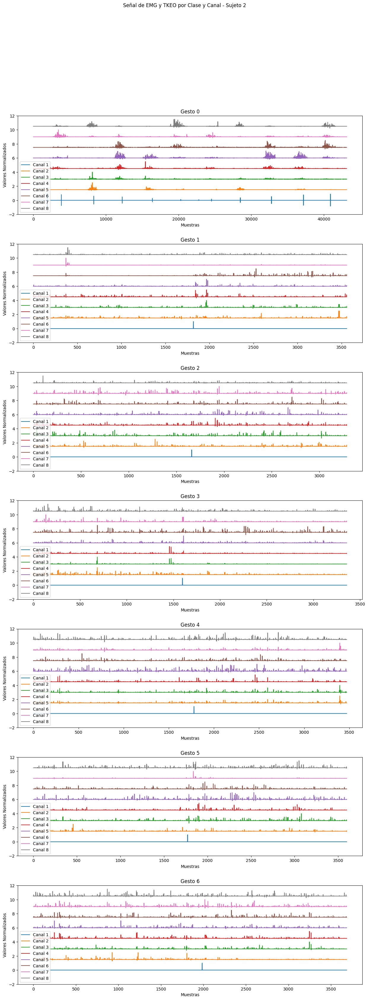

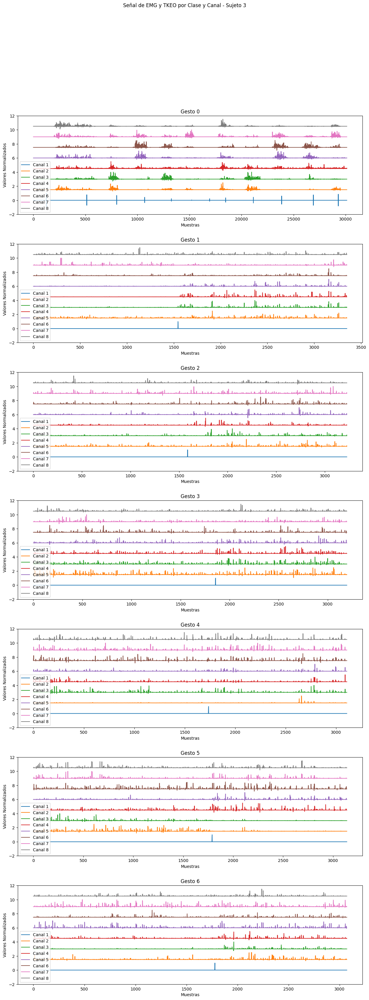

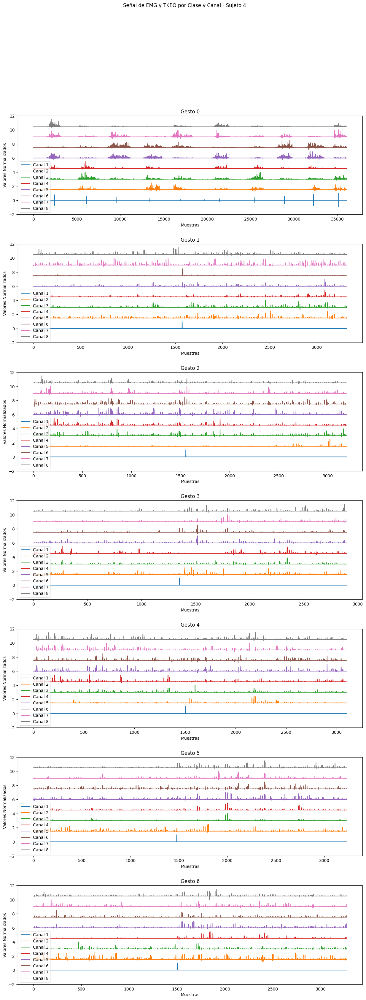

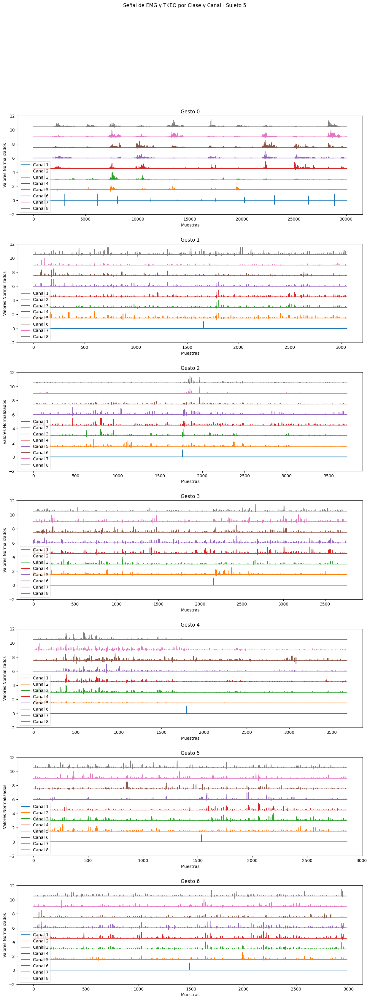

...

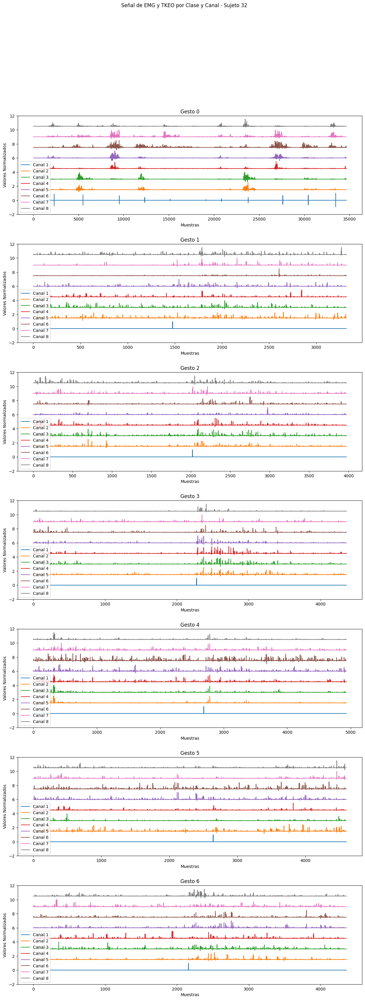

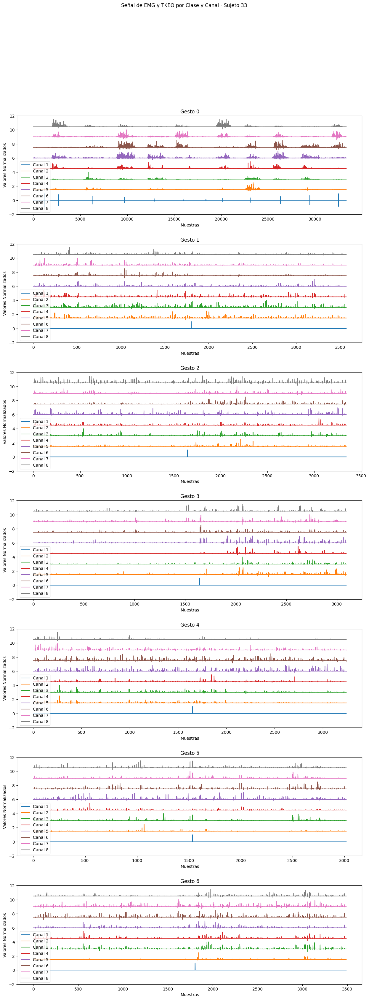

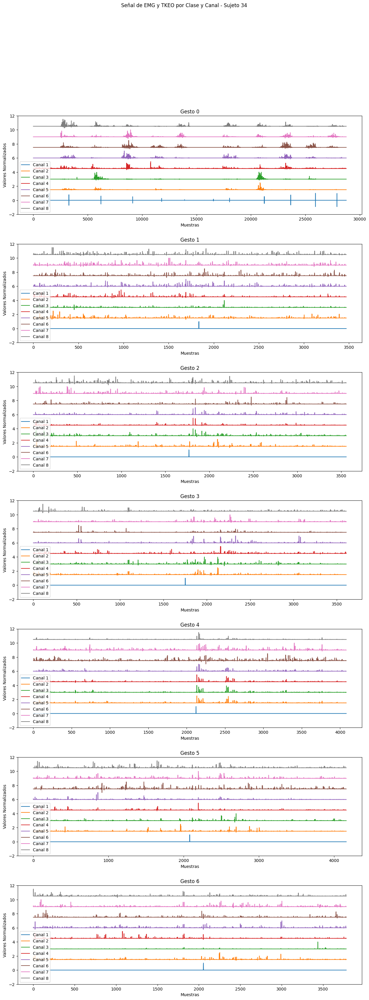

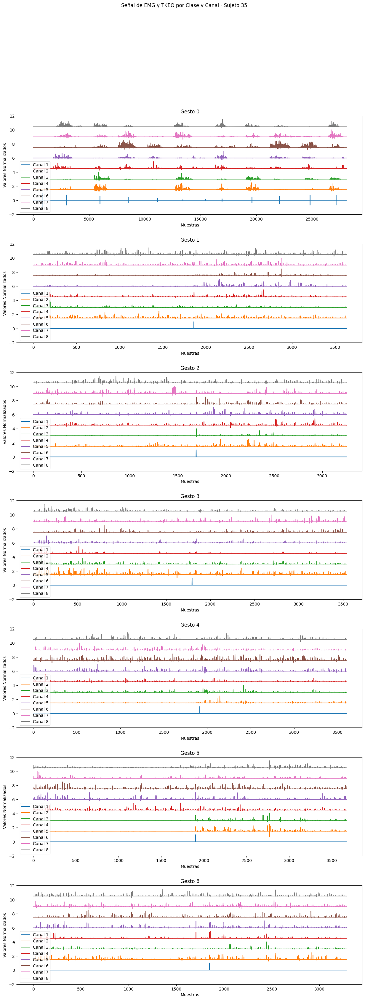

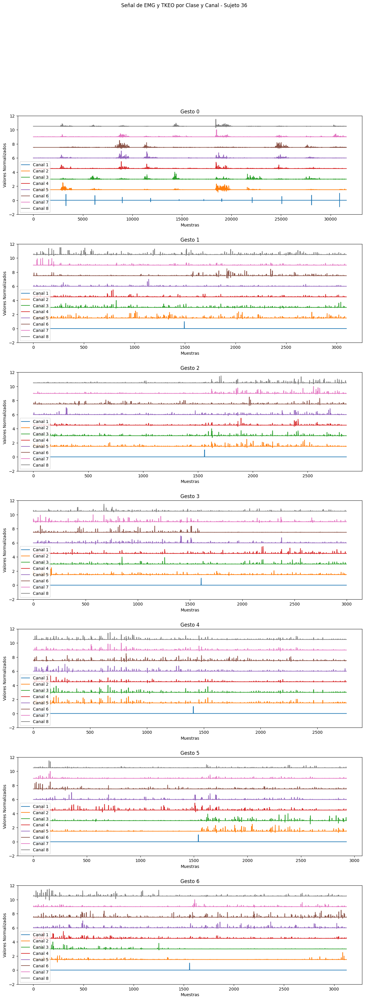

In [ ]:
def plot_emg_and_tkeo_by_class(file_path, subject_num):
    data = [] #leer los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data) #separar los datos por clase
    class_values = data[:, -1].astype(int)
    unique_classes = np.unique(class_values)

    #graficar la señal original y el TKEO por canal
    fig, axs = plt.subplots(len(unique_classes), 1, figsize=(15, 38))
    plt.subplots_adjust(hspace=0.3)
    plt.suptitle(f'Señal de EMG y TKEO por Clase y Canal - Sujeto {subject_num}')
    for i, class_value in enumerate(sorted(unique_classes)):
        class_mask = class_values == class_value
        class_data = data[class_mask]
        offset = 0
        for channel in range(8):
            channel_data = (class_data[:, channel] - np.mean(class_data[:, channel])) / np.std(class_data[:, channel])
            tkeo_result = np.zeros_like(channel_data)
            tkeo_result[1:-1] = channel_data[1:-1] ** 2 - channel_data[:-2] * channel_data[2:]
            tkeo_result_normalized = tkeo_result / np.max(np.abs(tkeo_result))
            tkeo_result_scaled = tkeo_result_normalized
            axs[i].plot(tkeo_result_scaled + offset, label=f'Canal {channel + 1}')
            offset += 1.5
        axs[i].set_title(f'Gesto {class_value}')
        axs[i].set_xlabel('Muestras')
        axs[i].set_ylabel('Valores Normalizados')
        axs[i].set_ylim(-2, 12)
        axs[i].legend()
    plt.show()

for i, sujeto_ejemplo in enumerate(listas_sujetos, 1):
    archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        plot_emg_and_tkeo_by_class(archivo_ejemplo, i)

**3. Crear una función que reciba una señal EMG de múltiples canales que extraiga las siguientes características para cada canal (esto solo lo hacemos para el sujeto 1)**
--
- RMS
- Varianza
- Mean Absolute Value
- Mean Absolute Value Slope
- Slope Sign Changes
- Wave form length
- Zero Crossing

*La correccion que nos sugirio la profe fue la siguiente: No se realiza sobre cada uno de los gestos*

Que le modificamos al codigo: Aca solamente estamos haciendo el codigo para el sujeto 1 pero tendriamos informacion sobre cada uno de los gestos

la función devuelve una matriz de características de forma (canales, 7), donde cada fila representa los valores de las 7 características para cada uno de los canales, por lo tanto, cuando se imprime los resultados, se ven los valores de las características para cada uno de los 8 canales del gesto 0 por ejemplo. Esto se hace para poder analizar la señal EMG por canal y tener una mejor comprensión de las características de la actividad muscular.


In [ ]:
def extract_emg_features_by_gesture(data, gesture_labels): #extrae las características de señales EMG por cada gesto.
    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)

    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask]

        rms = np.sqrt(np.mean(gesture_data[:, :-1] ** 2, axis=1))
        var = np.var(gesture_data[:, :-1], axis=1)
        mav = np.mean(np.abs(gesture_data[:, :-1]), axis=1)
        mavs = np.sum(np.abs(gesture_data[:, :-1]), axis=1)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data[:, :-1]), axis=1)), axis=1)
        wl = np.sum(np.abs(np.diff(gesture_data[:, :-1], axis=1)), axis=1)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data[:, :-1]), axis=1)) > 0, axis=1)

        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))

    return emg_features_by_gesture

In [ ]:
def plot_emg_and_tkeo_by_class(file_path):
  data = []   #leer los datos del archivo
  with open(file_path, 'r') as file:
    next(file)  #saltar la primera fila (encabezados)
    for line in file:
      values = [float(value) for value in line.strip().split('\t')]
      data.append(values)
  data = np.array(data)

  class_values = data[:, -1].astype(int) #separar los datos por clase
  unique_classes = np.unique(class_values)

  gesture_labels = class_values   #obtener las etiquetas de los gestos

  #extraer las características por gesto
  emg_features_by_gesture = extract_emg_features_by_gesture(data, gesture_labels)

  #imprimir los resultados
  print(f"Sujeto 1:")
  for gesture, features in emg_features_by_gesture.items():
    print(f"RMS para gesto {gesture}: {features[:, 0]}")
    print(f"Varianza para gesto {gesture}: {features[:, 1]}")
    print(f"MAV para gesto {gesture}: {features[:, 2]}")
    print(f"MAVS para gesto {gesture}: {features[:, 3]}")
    print(f"SSC para gesto {gesture}: {features[:, 4]}")
    print(f"WL para gesto {gesture}: {features[:, 5]}")
    print(f"ZC para gesto {gesture}: {features[:, 6]}")
    print()

sujeto_ejemplo = listas_sujetos[0]
archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
archivo_ejemplo = archivos_txt_ejemplo[0]
plot_emg_and_tkeo_by_class(archivo_ejemplo)


Sujeto 1:
RMS para gesto 0: [6.66666667e-01 2.00000000e+00 2.33333333e+00 ... 2.02166667e+04
 2.02170000e+04 2.02173333e+04]
Varianza para gesto 0: [3.95068148e-01 3.55557482e+00 4.83952864e+00 ... 3.63300988e+08
 3.63312968e+08 3.63324949e+08]
MAV para gesto 0: [2.22238889e-01 6.66683333e-01 7.77794444e-01 ... 6.73888890e+03
 6.73900001e+03 6.73911112e+03]
MAVS para gesto 0: [2.00015000e+00 6.00015000e+00 7.00015000e+00 ... 6.06500001e+04
 6.06510001e+04 6.06520001e+04]
SSC para gesto 0: [ 6.  6.  6. ... 10. 10. 10.]
WL para gesto 0: [2.00013000e+00 6.00013000e+00 7.00013000e+00 ... 6.06500001e+04
 6.06510001e+04 6.06520001e+04]
ZC para gesto 0: [3. 3. 3. ... 7. 7. 7.]

RMS para gesto 1: [  293.33333333   293.66666667   294.         ... 11061.66666667
 11062.         11063.        ]
Varianza para gesto 1: [7.64839567e+04 7.66578826e+04 7.68320061e+04 ... 1.08764862e+08
 1.08771417e+08 1.08791083e+08]
MAV para gesto 1: [  97.77780889   97.88892      98.00003111 ... 3687.22223111 3687.3

**4. Crear una rutina que aplique sobre todo los archivos de la base de datos las funciones descritas en 2 y 3**
--

*La correccion que nos sugirio la profe fue la siguiente: No se realiza sobre cada uno de los gestos*

Que le modificamos al codigo: Aca hacemos el codigo para que recorra todos los sujetos, tendriamos informacion sobre cada uno de los gestos para los 36 sujetos

In [ ]:
def plot_emg_and_tkeo_by_class(file_path):
    data = []   #leerlos datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #salta la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data) #separar los datos por clase
    class_values = data[:, -1].astype(int)
    unique_classes = np.unique(class_values)
    gesture_labels = class_values

    #extraer las características por gesto
    emg_features_by_gesture = extract_emg_features_by_gesture(data, gesture_labels)

    #imprime los resultados por sujeto
    subject_num = 1
    for subject_path in listas_sujetos:
        print(f"Sujeto {subject_num}:")
        for gesture, features in emg_features_by_gesture.items():
            print(f"RMS para gesto {gesture}: {features[:, 0]}")
            print(f"Varianza para gesto {gesture}: {features[:, 1]}")
            print(f"MAV para gesto {gesture}: {features[:, 2]}")
            print(f"MAVS para gesto {gesture}: {features[:, 3]}")
            print(f"SSC para gesto {gesture}: {features[:, 4]}")
            print(f"WL para gesto {gesture}: {features[:, 5]}")
            print(f"ZC para gesto {gesture}: {features[:, 6]}")
        print()
        subject_num += 1


for subject_path in listas_sujetos:
    archivos_txt_ejemplo = glob.glob(os.path.join(subject_path, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        plot_emg_and_tkeo_by_class(archivo_ejemplo)

Se han truncado las últimas 5000 líneas del flujo de salida.
 16550.66666667 16551.        ]
Varianza para gesto 6: [5.35543502e+07 5.35589500e+07 5.35635500e+07 ... 2.43478696e+08
 2.43488504e+08 2.43498313e+08]
MAV para gesto 6: [2587.33361111 2587.44472222 2587.55583333 ... 5516.77796222 5516.88907333
 5517.00018667]
MAVS para gesto 6: [23286.0025  23287.0025  23288.0025  ... 49651.00166 49652.00166
 49653.00168]
SSC para gesto 6: [ 8.  8.  8. ... 10. 10. 10.]
WL para gesto 6: [23286.00286 23287.00286 23288.00286 ... 49651.00254 49652.00254
 49653.00303]
ZC para gesto 6: [4. 4. 4. ... 6. 6. 5.]

Sujeto 15:
RMS para gesto 0: [3.33333334e-01 2.00000000e+00 2.33333333e+00 ... 1.68806667e+04
 1.68810000e+04 1.68813333e+04]
Varianza para gesto 0: [9.87671606e-02 3.55557481e+00 4.83950790e+00 ... 2.53295029e+08
 2.53305032e+08 2.53315036e+08]
MAV para gesto 0: [1.11118889e-01 6.66683333e-01 7.77787778e-01 ... 5.62688891e+03
 5.62700002e+03 5.62711113e+03]
MAVS para gesto 0: [1.00007000e+0

**5. Crear una rutina que aplique sobre todo los archivos de la base de datos las función 3 sobre las señales originales**
--

In [ ]:
def extract_emg_features_by_gesture_original(data, gesture_labels):#extrae las características de señales EMG por cada gesto sin aplicar el TKEO
    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)

    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask, :-1]  #obtiene solo los datos de EMG sin la última columna

        rms = np.sqrt(np.mean(gesture_data ** 2, axis=1))
        var = np.var(gesture_data, axis=1)
        mav = np.mean(np.abs(gesture_data), axis=1)
        mavs = np.sum(np.abs(gesture_data), axis=1)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=1)), axis=1)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=1)), axis=1)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=1)) > 0, axis=1)

        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))

    return emg_features_by_gesture

def plot_emg_features_by_class(file_path):
    data = [] #lee los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data) #separar los datos por clase
    class_values = data[:, -1].astype(int)
    gesture_labels = class_values

    #extraer las características por gesto
    emg_features_by_gesture = extract_emg_features_by_gesture_original(data, gesture_labels)

    #imprime los resultados por sujeto
    subject_num = 1
    for subject_path in listas_sujetos:
        print(f"Sujeto {subject_num}:")
        for gesture, features in emg_features_by_gesture.items():
            print(f"RMS para gesto {gesture}: {features[:, 0]}")
            print(f"Varianza para gesto {gesture}: {features[:, 1]}")
            print(f"MAV para gesto {gesture}: {features[:, 2]}")
            print(f"MAVS para gesto {gesture}: {features[:, 3]}")
            print(f"SSC para gesto {gesture}: {features[:, 4]}")
            print(f"WL para gesto {gesture}: {features[:, 5]}")
            print(f"ZC para gesto {gesture}: {features[:, 6]}")
            print()
        subject_num += 1


for subject_path in listas_sujetos:
    archivos_txt_ejemplo = glob.glob(os.path.join(subject_path, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        plot_emg_features_by_class(archivo_ejemplo)

Se han truncado las últimas 5000 líneas del flujo de salida.
 41084.00104]
SSC para gesto 4: [4. 4. 4. ... 2. 2. 2.]
WL para gesto 4: [14311.00194 14312.00194 14313.00194 ... 41082.00124 41083.00124
 41084.00124]
ZC para gesto 4: [2. 2. 2. ... 1. 1. 1.]

RMS para gesto 5: [ 6332.66666667  6333.          6333.33333333 ... 15248.66666667
 15249.         15249.33333333]
Varianza para gesto 5: [3.56468154e+07 3.56505682e+07 3.56543212e+07 ... 2.06686076e+08
 2.06695113e+08 2.06704149e+08]
MAV para gesto 5: [2110.88899667 2111.00010778 2111.11121889 ... 5082.88896222 5083.00007333
 5083.11118444]
MAVS para gesto 5: [18998.00097 18999.00097 19000.00097 ... 45746.00066 45747.00066
 45748.00066]
SSC para gesto 5: [6. 6. 6. ... 8. 8. 8.]
WL para gesto 5: [18998.00122 18999.00122 19000.00122 ... 45746.00106 45747.00106
 45748.00106]
ZC para gesto 5: [3. 3. 3. ... 4. 4. 4.]

RMS para gesto 6: [ 7762.          7762.33333333  7762.66666667 ... 16550.33333333
 16550.66666667 16551.        ]
Varianza

**6. Almanecene las métricas obtenidas en el ítem 4 y 5 en un dataframe, en donde haya una columna que discrimine si las caracteristicas proviene de una señal con TKEO o sin TKEO**
--

In [ ]:
def extract_emg_features_by_gesture(data, gesture_labels): #extrae caracteristicas de señales por cada gesto con tkeo
    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)

    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask]

        rms = np.sqrt(np.mean(gesture_data[:, :-1] ** 2, axis=1))
        var = np.var(gesture_data[:, :-1], axis=1)
        mav = np.mean(np.abs(gesture_data[:, :-1]), axis=1)
        mavs = np.sum(np.abs(gesture_data[:, :-1]), axis=1)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data[:, :-1]), axis=1)), axis=1)
        wl = np.sum(np.abs(np.diff(gesture_data[:, :-1], axis=1)), axis=1)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data[:, :-1]), axis=1)) > 0, axis=1)

        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))
    return emg_features_by_gesture

def extract_emg_features_by_gesture_original(data, gesture_labels): #extrae las características de señales EMG sin aplicar el tkeo
    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)

    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask, :-1]  #obtiene solo los datos de EMG, sin la última columna

        rms = np.sqrt(np.mean(gesture_data ** 2, axis=1))
        var = np.var(gesture_data, axis=1)
        mav = np.mean(np.abs(gesture_data), axis=1)
        mavs = np.sum(np.abs(gesture_data), axis=1)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=1)), axis=1)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=1)), axis=1)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=1)) > 0, axis=1)

        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))

    return emg_features_by_gesture

def create_features_dataframe(listas_sujetos):
    all_features = []
    for subject_path in listas_sujetos:
        archivos_txt_ejemplo = glob.glob(os.path.join(subject_path, "2*.txt"))
        for archivo_ejemplo in archivos_txt_ejemplo:
            data = [] #lee los datos del archivo
            with open(archivo_ejemplo, 'r') as file:
                next(file)  #salta la primera fila
                for line in file:
                    values = [float(value) for value in line.strip().split('\t')]
                    data.append(values)
            data = np.array(data)

            #separa los datos por clase
            class_values = data[:, -1].astype(int)
            gesture_labels = class_values

            #---- extraer las características por gesto con TKEO
            emg_features_by_gesture = extract_emg_features_by_gesture(data, gesture_labels)
            for gesture, features in emg_features_by_gesture.items():
                features_df = pd.DataFrame(features, columns=['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'])
                features_df['Gesto'] = gesture
                features_df['TKEO'] = 'Sí'
                all_features.append(features_df)

            #----- extraer las características por gesto sin TKEO
            emg_features_by_gesture_original = extract_emg_features_by_gesture_original(data, gesture_labels)
            for gesture, features in emg_features_by_gesture_original.items():
                features_df = pd.DataFrame(features, columns=['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'])
                features_df['Gesto'] = gesture
                features_df['TKEO'] = 'No'
                all_features.append(features_df)

    return pd.concat(all_features, ignore_index=True)

features_df = create_features_dataframe(listas_sujetos)
print(features_df)

                  RMS      Varianza          MAV         MAVS   SSC  \
0            0.666667  3.950681e-01     0.222239      2.00015   6.0   
1            2.000000  3.555575e+00     0.666683      6.00015   6.0   
2            2.333333  4.839529e+00     0.777794      7.00015   6.0   
3            2.666667  6.321037e+00     0.888917      8.00025   5.0   
4            3.000000  8.000013e+00     1.000009      9.00008   8.0   
...               ...           ...          ...          ...   ...   
4083869  16742.000000  2.491507e+08  5580.666699  50226.00029   5.0   
4083870  16742.333333  2.491606e+08  5580.777810  50227.00029   5.0   
4083871  16742.666667  2.491706e+08  5580.888921  50228.00029   5.0   
4083872  16743.000000  2.491805e+08  5581.000063  50229.00057  10.0   
4083873  16743.333333  2.491904e+08  5581.111174  50230.00057  10.0   

                  WL   ZC Gesto TKEO  
0            2.00013  3.0     0   Sí  
1            6.00013  3.0     0   Sí  
2            7.00013  3.0     

El código es una herramienta para el análisis de señales de EMG y gracias al dataframe se permite extraer características relevantes que pueden ser utilizadas en diversas aplicaciones relacionadas con el reconocimiento de gestos y el estudio de la actividad muscular, esto seria posible porque al comparar las características extraídas con y sin la aplicación del operador TKEO, se puede investigar si este procesamiento no lineal de la señal aporta información relevante para diferenciar los patrones de actividad muscular entre los diferentes gestos realizados.


**7. Realice un análisis exploratorio de los datos (Estadística descriptiva) teniendo como base la teoría vista en clase (Diagramas de cajas, gráficos, medidas de tendencia central)**
--

<Figure size 1000x1500 with 0 Axes>

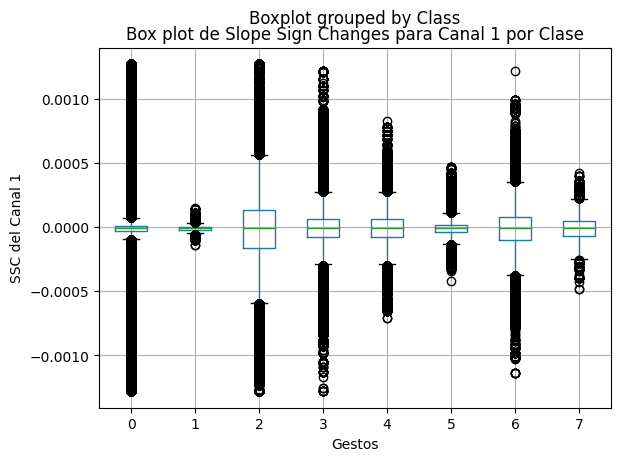

In [ ]:
##aca queremos realizar un analisis por meido de boxplot utilizando los gestos del sujeto y su valor de slope sign changes

def extract_ssc_class(file_path):
    data = []
    #lee los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #saltar la primera fila
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)
    data = np.array(data)

    #extraer los valores de slope sign changes del canal 1 y la clase
    ssc_values = data[:, 7]  #valores de SSC del canal 1
    class_values = data[:, -1].astype(int) #gesto correspondiente
    return ssc_values, class_values

all_ssc_values = [] #listas para almacenar los valores de SSC y las clases de todos los sujetos para cada gesto
all_class_values = []

for sujeto_ejemplo in listas_sujetos: #iteramos sobre los diferentes sujetos y archivos
    archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        ssc_values, class_values = extract_ssc_class(archivo_ejemplo)
        all_ssc_values.extend(ssc_values)
        all_class_values.extend(class_values)

df_ssc_class = pd.DataFrame({'SSC': all_ssc_values, 'Class': all_class_values}) #dataframe con los datos

#se genera el box plot para SSC del canal 1 por clase
plt.figure(figsize=(10, 15))
boxplot = df_ssc_class.boxplot(column='SSC', by='Class', vert=True)
plt.title('Box plot de Slope Sign Changes para Canal 1 por Clase')
plt.xlabel('Gestos')
plt.ylabel('SSC del Canal 1')
plt.show()


<Figure size 1500x1500 with 0 Axes>

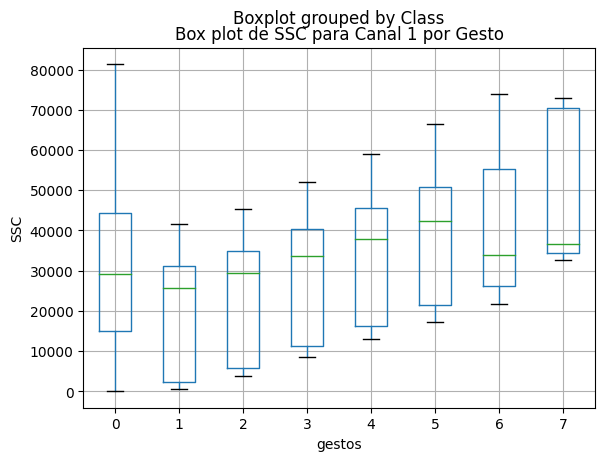

<Figure size 1500x1500 with 0 Axes>

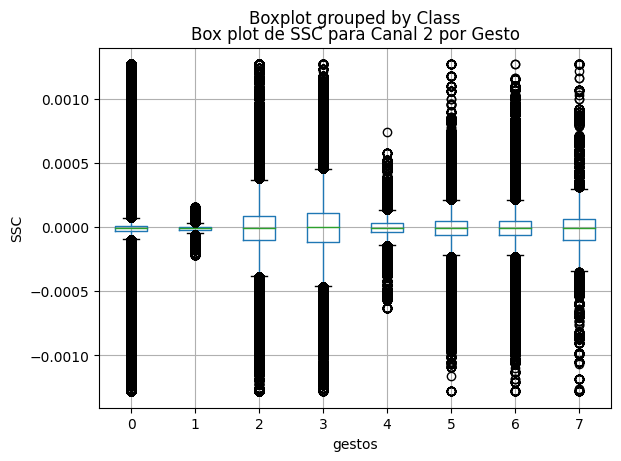

<Figure size 1500x1500 with 0 Axes>

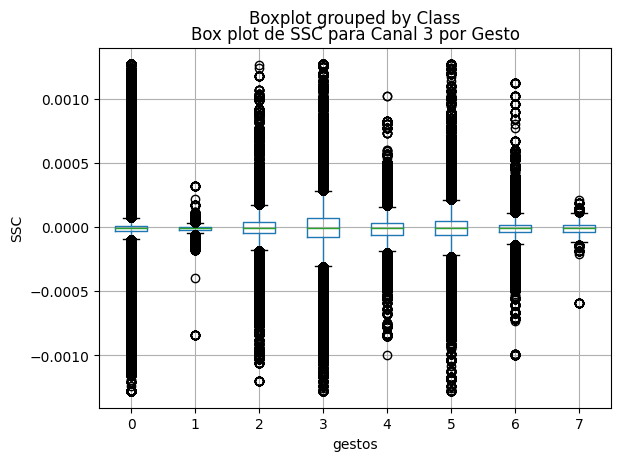

<Figure size 1500x1500 with 0 Axes>

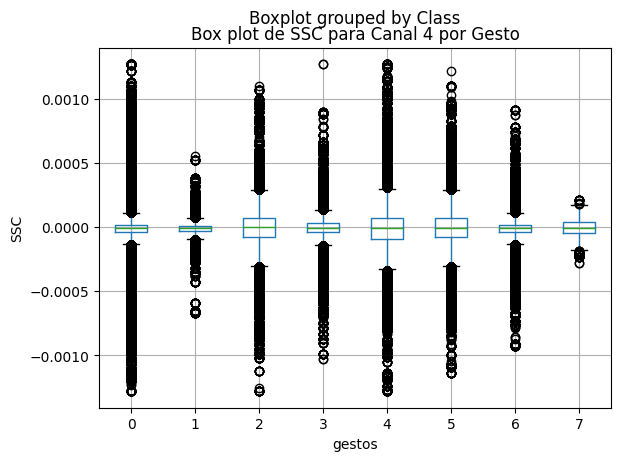

<Figure size 1500x1500 with 0 Axes>

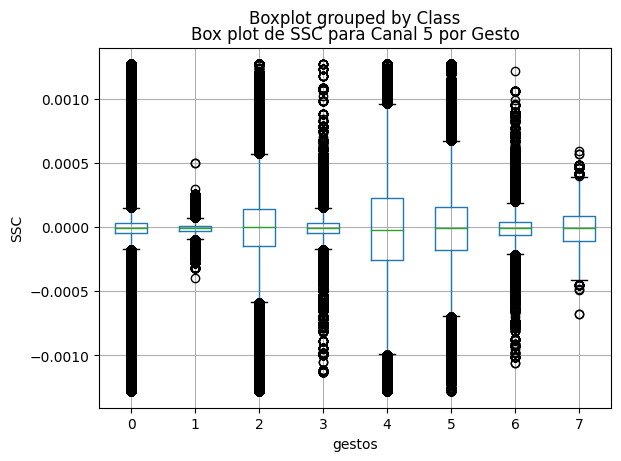

<Figure size 1500x1500 with 0 Axes>

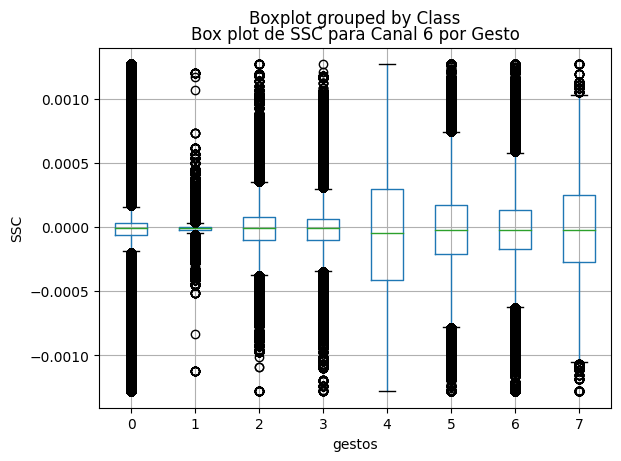

<Figure size 1500x1500 with 0 Axes>

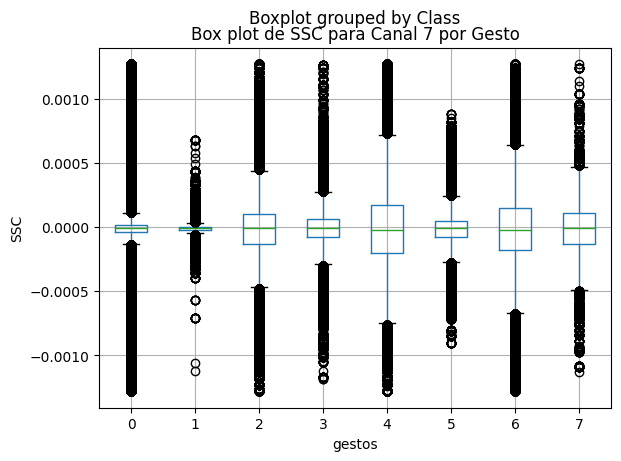

<Figure size 1500x1500 with 0 Axes>

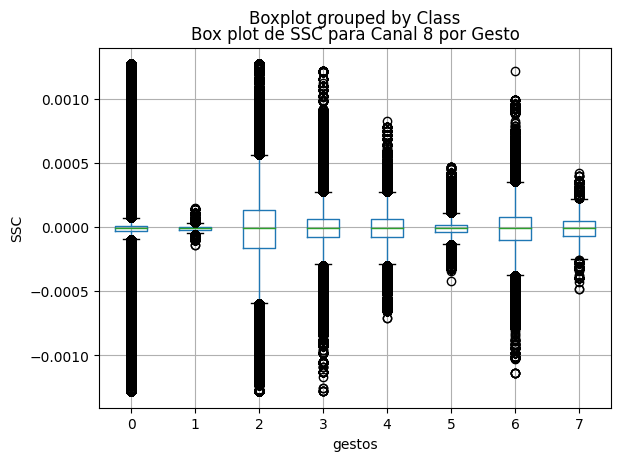

In [ ]:
def extract_ssc_class(file_path):
    data = []
    #lee los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)
    data = np.array(data)

    #extraer los valores de Slope Sign Changes de todos los canales y la clase
    ssc_values = data[:, :8]  #valores de SSC de todos los canales
    class_values = data[:, -1].astype(int)  #gestos
    return ssc_values, class_values

all_ssc_values = {i: [] for i in range(1, 9)} #listas para almacenar los valores de SSC y las clases de todos los sujetos para todos los canales
all_class_values = []

#iteramos sobre los diferentes sujetos y archivos
for sujeto_ejemplo in listas_sujetos:
    archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        ssc_values, class_values = extract_ssc_class(archivo_ejemplo)
        for i, ssc_channel_values in enumerate(ssc_values.T, 1):
            all_ssc_values[i].extend(ssc_channel_values)
        all_class_values.extend(class_values)

#dataframe con los datos
df_ssc_class = pd.DataFrame({f'SSC_Canal{i}': ssc_values for i, ssc_values in all_ssc_values.items()})
df_ssc_class['Class'] = all_class_values

#box plots con los ejes intercambiados y separados en subplots
for canal, data in all_ssc_values.items():
    plt.figure(figsize=(15, 15))
    df = pd.DataFrame({'SSC': data, 'Class': all_class_values})
    boxplot = df.boxplot(column='SSC', by='Class', vert=True)
    plt.title(f'Box plot de SSC para Canal {canal} por Gesto')
    plt.xlabel('gestos')
    plt.ylabel('SSC')
    plt.show()


Como parte del análisis estadístico se decidió hacer el boxplot del SSC (SLOPE SIGN CHANGES), para mostrar las distribuciones de cambios de signos de la pendiente para cada gesto en los 8 canales de todos los sujetos y permitiendo identificar posibles diferencias en los cambios de la dirección de la tendencia de los datos para todos los diferentes tipos de gestos.

Entre los datos de SSC para los sujetos, se tiene que el gesto que está más cercano al 50% de los valores es el gesto 2 para los canales 1, 2, 3, 5 y 8, es decir que los cambios de signos no fueron tan diferentes entre los sujetos para este gesto.

Por otro lado, el gesto en el que se pudo observar mayores diferencias entre canales fuerons los gestos 4 y 6, los cuales corresponende a los gestos de extensión de muñeca y desviaciones cubitales respectivamente.

Además, en el diagrama de caja y bigotes, los puntos negros en bolitas que se encuentran fuera de las cajas y los bigotes representan valores atípicos o outliers, estos valores atípicos son aquellos que se desvían significativamente de la distribución principal de los datos para cada gesto y canal, en este caso la presencia de valores atípicos puede indicar variaciones inusuales en los cambios de signos de la pendiente para gestos específicos, lo cual podría ser útil para identificar patrones o comportamientos poco comunes en los datos


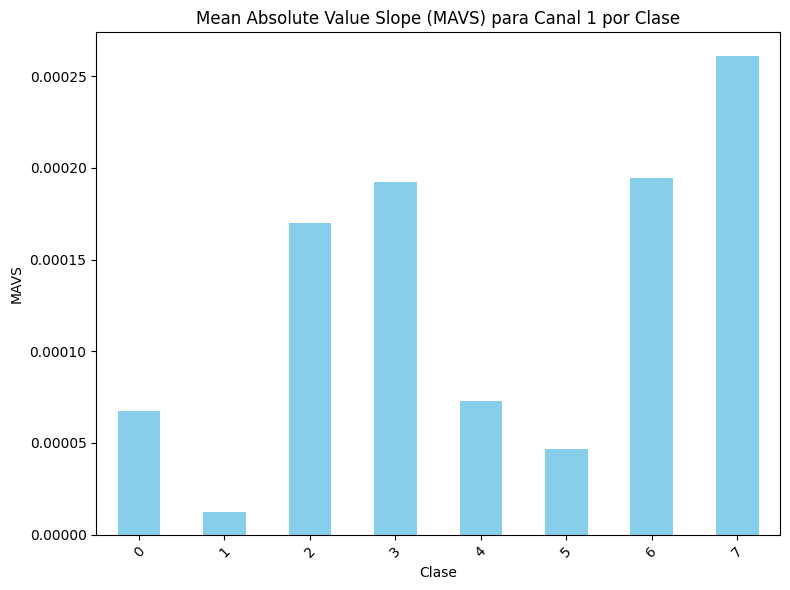

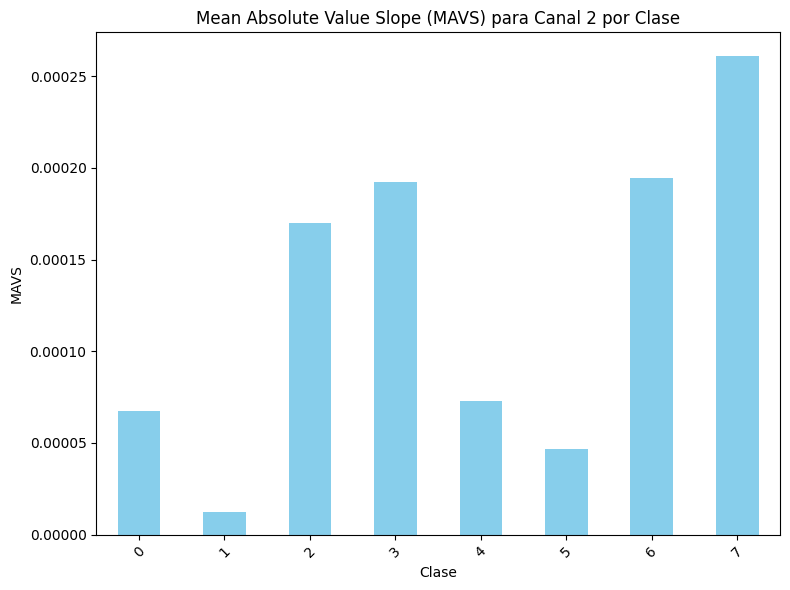

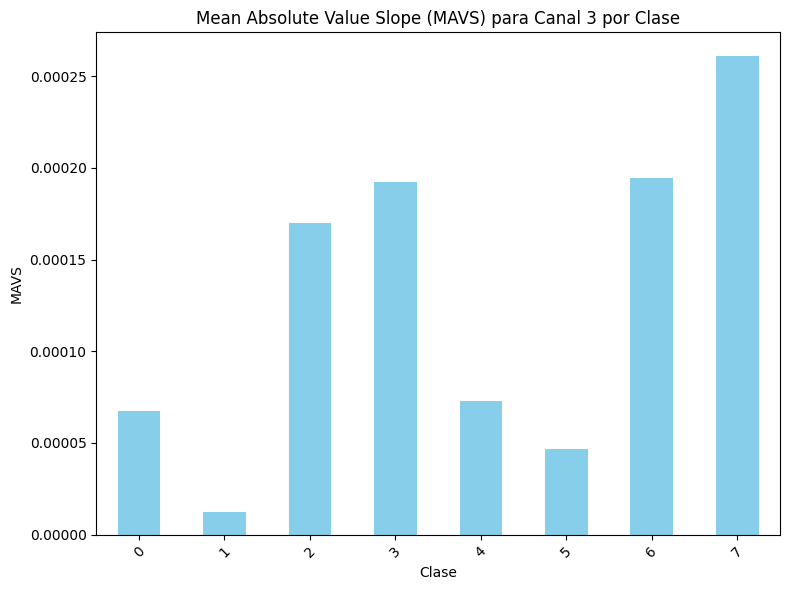

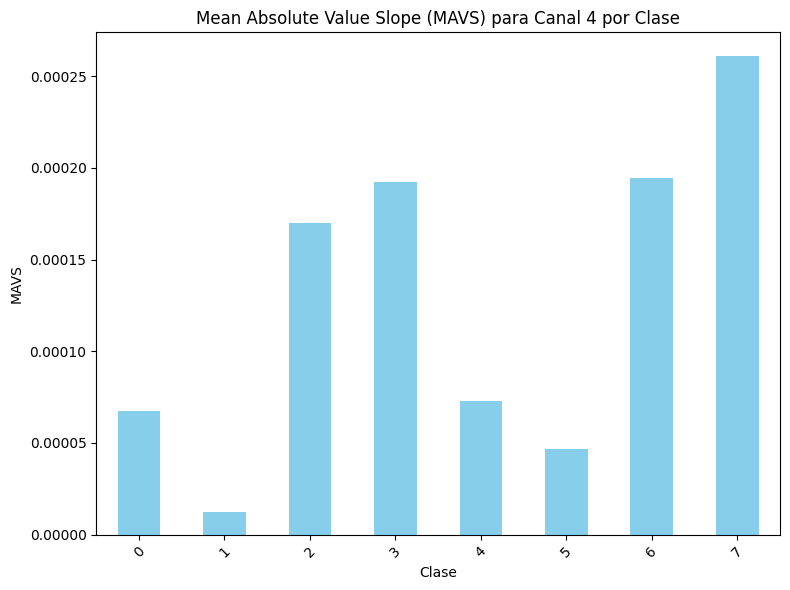

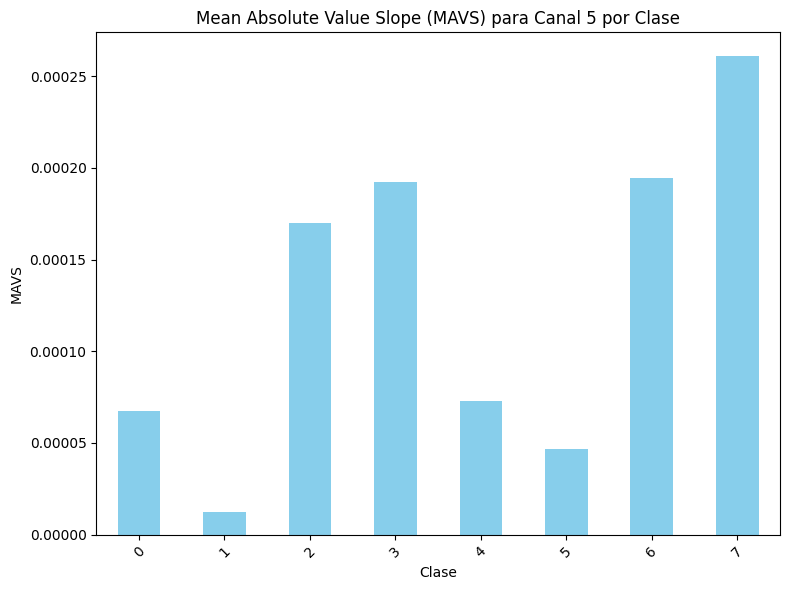

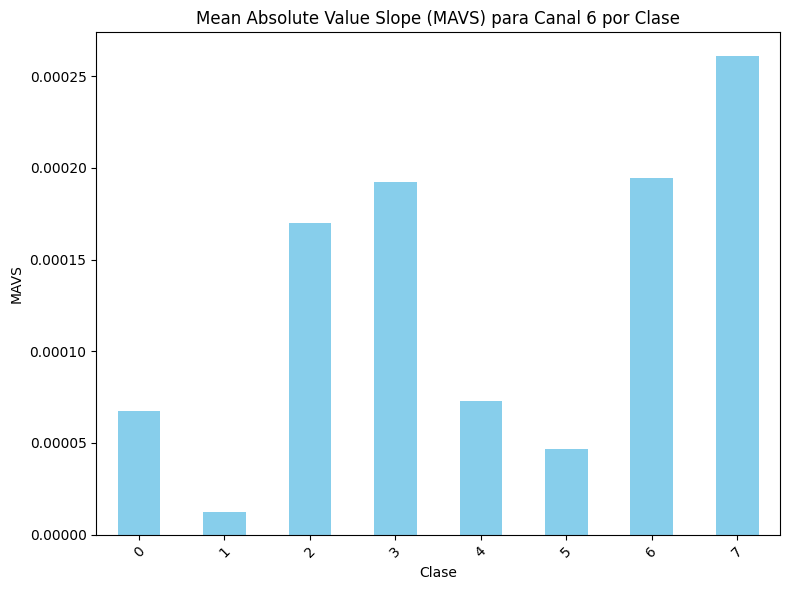

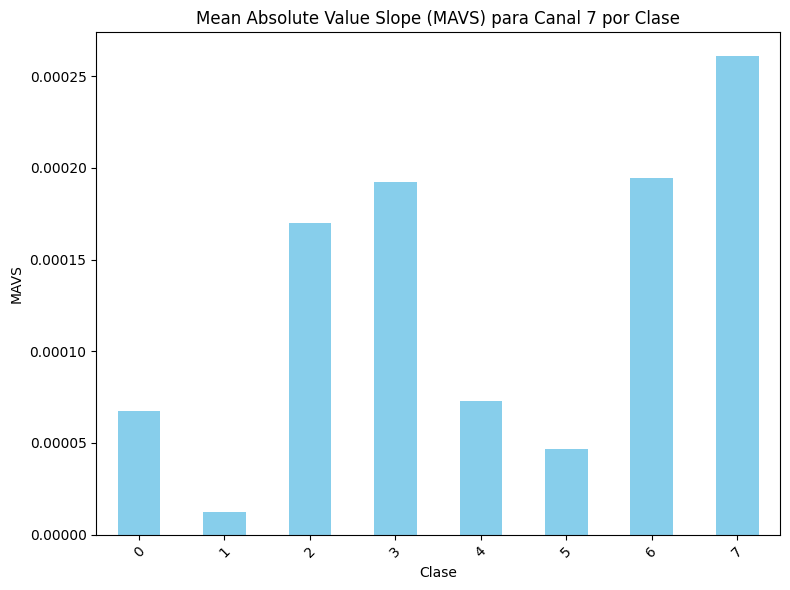

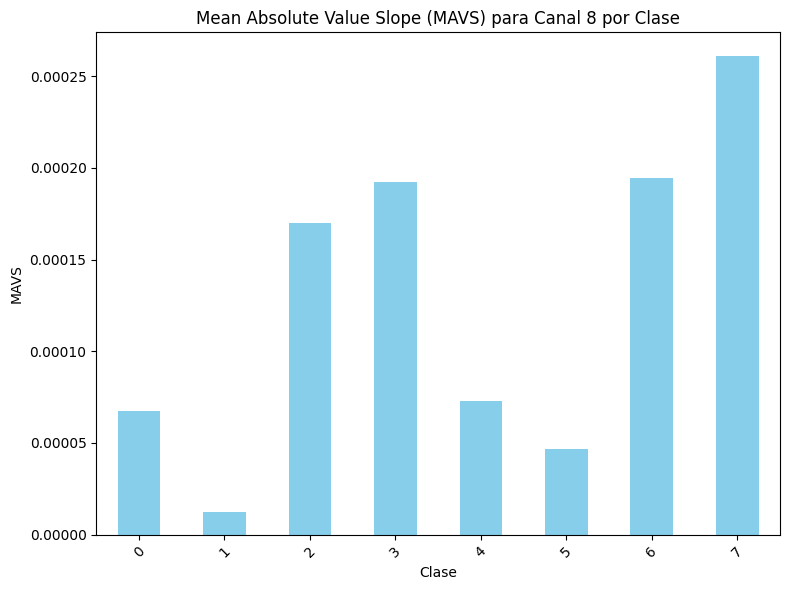

In [ ]:
def extract_mavs_class(file_path):
    data = []
    with open(file_path, 'r') as file: #lee los datos del archivo
        next(file)  #salta la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)
    data = np.array(data)

    #extraer los valores del MAVS de todos los canales y la clase
    mavs_values = np.abs(data[:, 8])  #valores MAVS de todos los canales (aplicando valor absoluto)
    class_values = data[:, -1].astype(int)  #gestos
    return mavs_values, class_values

all_mavs_values = {i: [] for i in range(1, 9)}  #listas para almacenar los valores MAVS y las clases de todos los sujetos para todos los canales
all_class_values = []

#iteramos sobre los diferentes sujetos y archivos
for sujeto_ejemplo in listas_sujetos:
    archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        mavs_values, class_values = extract_mavs_class(archivo_ejemplo)
        for i in range(1, 9):  #iterar sobre los canales
            all_mavs_values[i].extend(mavs_values)
        all_class_values.extend(class_values)

#graficar MAVS para cada clase y canal
for canal, data in all_mavs_values.items():
    plt.figure(figsize=(8, 6))
    df = pd.DataFrame({'MAVS': data, 'Class': all_class_values})
    df.groupby('Class')['MAVS'].mean().plot(kind='bar', color='skyblue')
    plt.title(f'Mean Absolute Value Slope (MAVS) para Canal {canal} por Clase')
    plt.xlabel('Clase')
    plt.ylabel('MAVS')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

Se hizo un grafico de barras para mostrar la pendiente de valor absoluto medio para cada gesto y canal de EMG y de esta manera comparar la medida de tendencia central del MAVS, proporcionando una representación visual clara de cómo varían estas medidas en los diferentes gestos suministrados.

Teniendo en cuenta que la pendiente del valor absoluto medio indica la tendencia general de los cambios en los datos a lo largo del tiempo, en este caso de cada gesto,se puede observar que el gesto 7: palma extendida, es el que tiene meyor MAVS, es decir que se podría llegar a indicar que la señal EMG tiene muchos cambios signficativos en la amplitud de la señal a lo largo del tiempo, es decir que se podría deducir que la señal es ese gesto es relativamente inestable, lo cual tiene sentido porque entre cada sujeto puede haber diferencias en el equilibrio de la mano en esa posicion

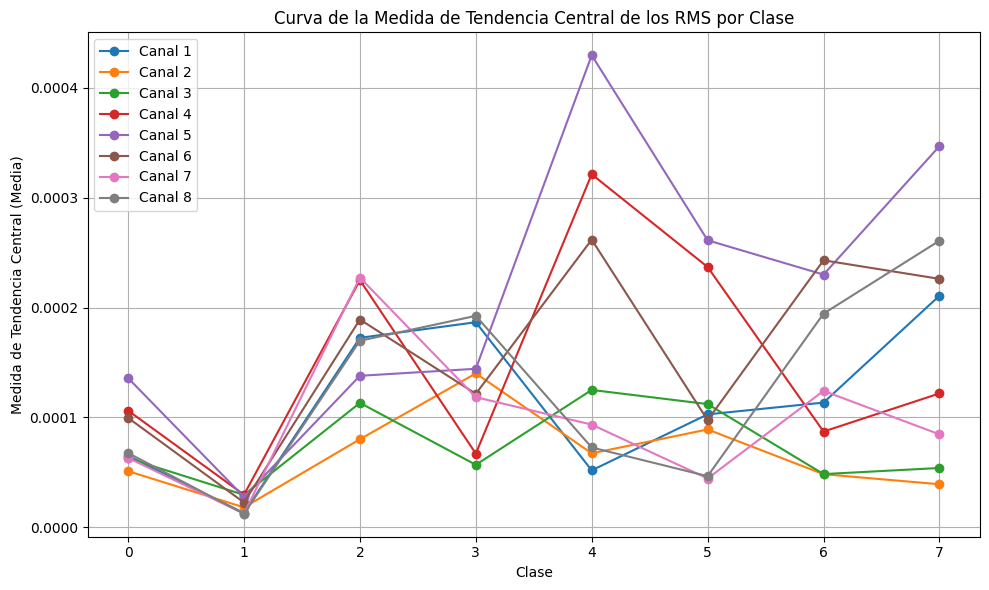

In [ ]:
def extract_rms_all_channels(file_path):
    data = []
    with open(file_path, 'r') as file: #lee los datos del archivo
        next(file)  #salta la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)
    data = np.array(data)

    #extraer los valores RMS de todos los canales y la clase
    rms_values = np.abs(data[:, 1:9])  #vlores RMS de todos los canales canales 1 - 8
    class_values = data[:, -1].astype(int)  #gstos
    return rms_values, class_values

all_rms_values = [[] for _ in range(8)]  #listas para almacenar los valores RMS de cada canal
all_class_values = []

for sujeto_ejemplo in listas_sujetos: #itera sobre los diferentes sujetos y archivos
    archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        rms_values, class_values = extract_rms_all_channels(archivo_ejemplo)
        for i in range(8):  #iterar sobre los canales
            all_rms_values[i].extend(rms_values[:, i])
        all_class_values.extend(class_values)

df_rms_class = pd.DataFrame({f'RMS_Canal{i+1}': all_rms_values[i] for i in range(8)}, index=all_class_values)

#graficar
plt.figure(figsize=(10, 6))
for i in range(8):
    plt.plot(df_rms_class.index.unique(), df_rms_class.groupby(level=0)[f'RMS_Canal{i+1}'].mean(), marker='o', linestyle='-', label=f'Canal {i+1}')

plt.title('Curva de la Medida de Tendencia Central de los RMS por Clase')
plt.xlabel('Clase')
plt.ylabel('Medida de Tendencia Central (Media)')
plt.xticks(np.unique(all_class_values))
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

El diagrama de la curva de la medida de la tendencia central, la medida de la tendencia central bajo la curva del RMS te proporciona información sobre la magnitud promedio de la señal EMG y su variabilidad a lo largo del tiempo, lo que te permite realizar comparaciones entre gestos, evaluar la estabilidad de la señal y detectar posibles anomalías.

Los canales que tienen valores de rms mas altos indican tener una mayor activacion muscular al realizar esos gestos especificos, analizar si hay patrones consistentes en los canales con nos ayuda a entender el comportamiento de los musculos. Ademas debemos de entender que si hay mucha diferencia entre las graficas estamos observando tambien la variabilidad de los datos para diferenciar gestos.

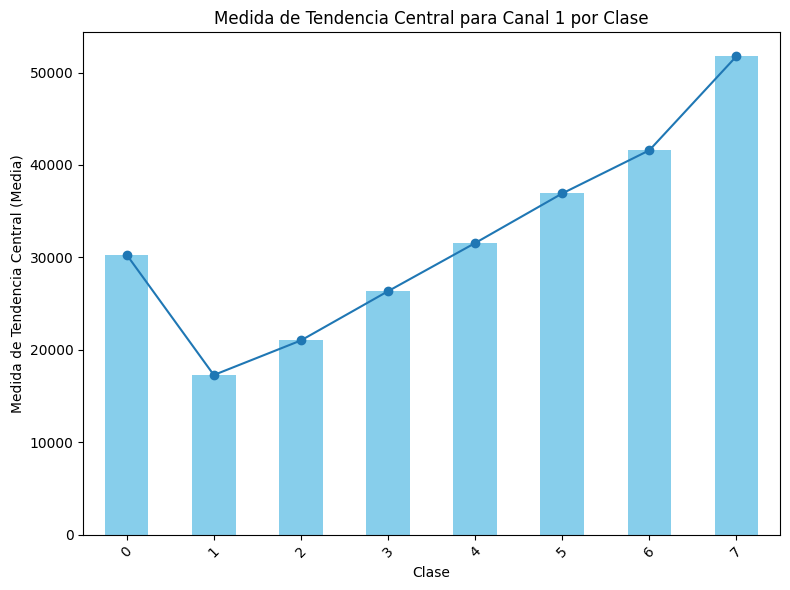

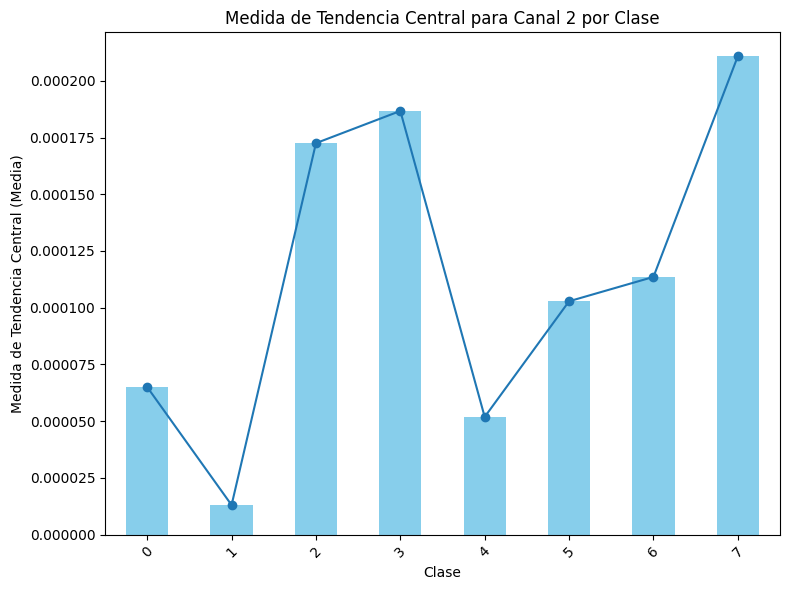

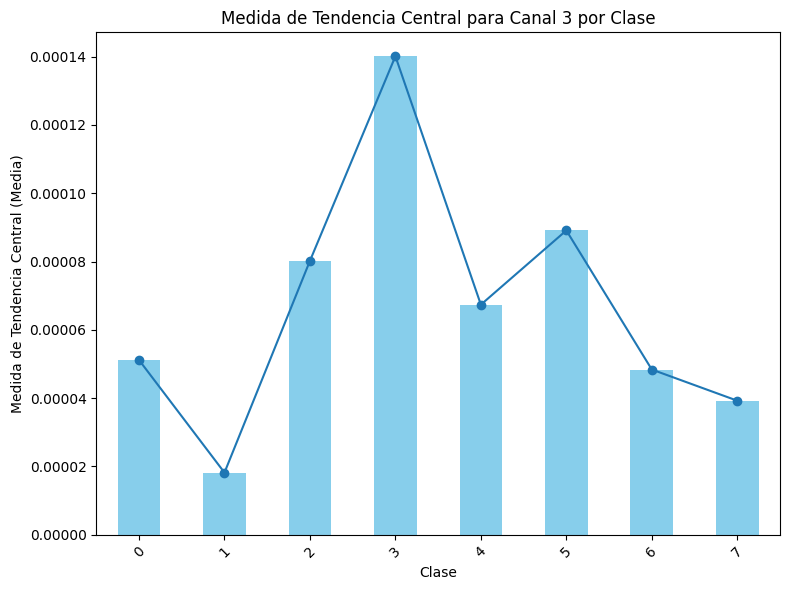

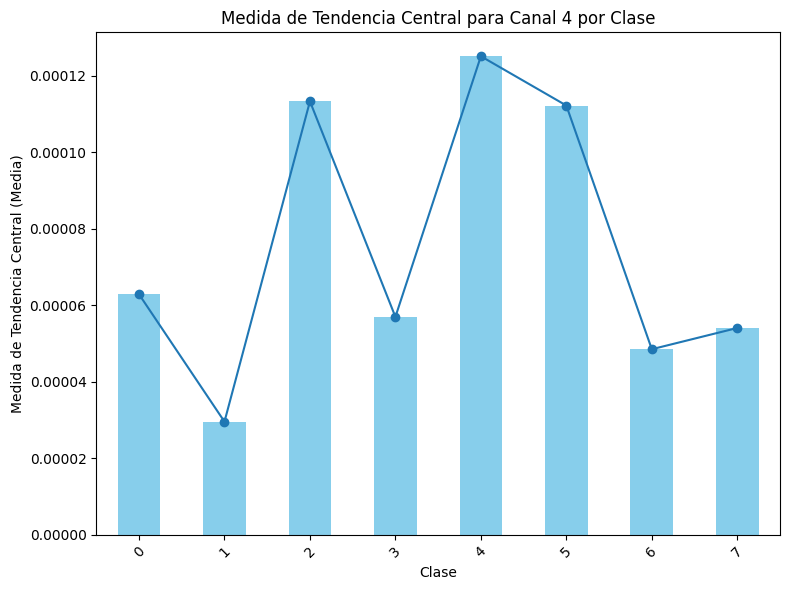

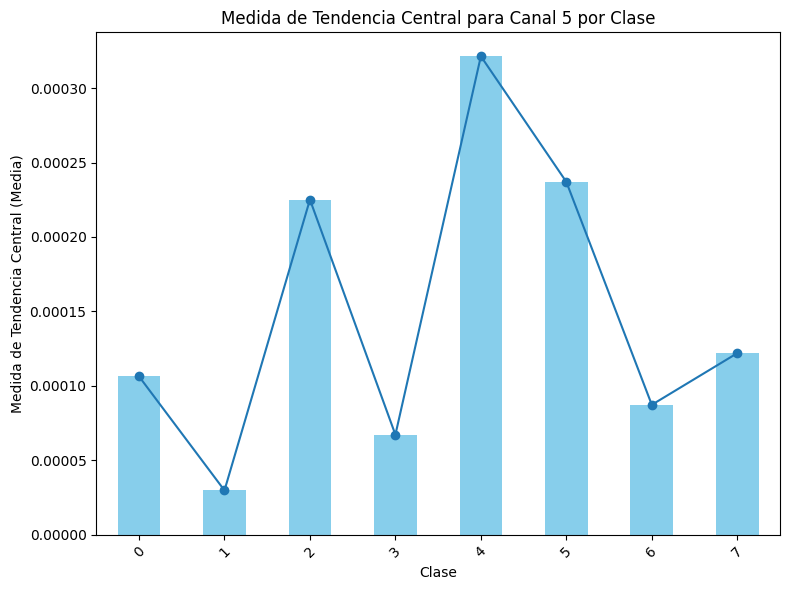

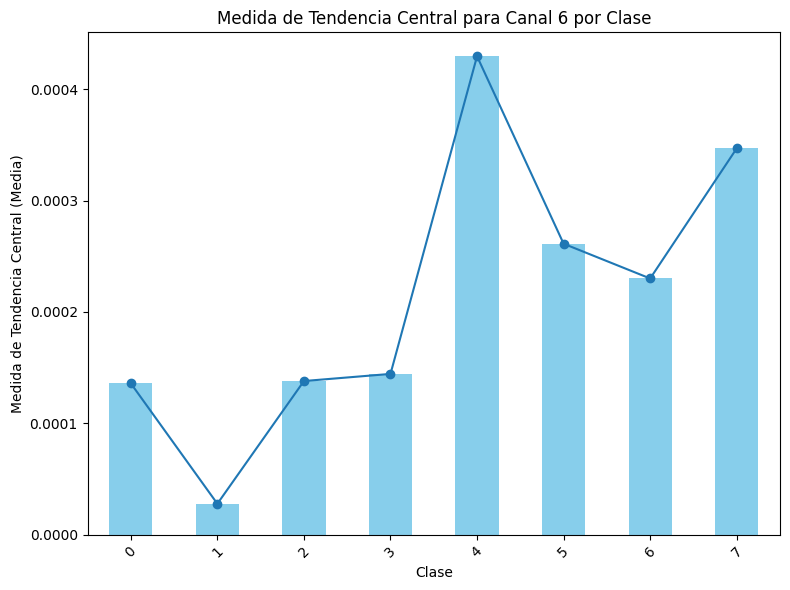

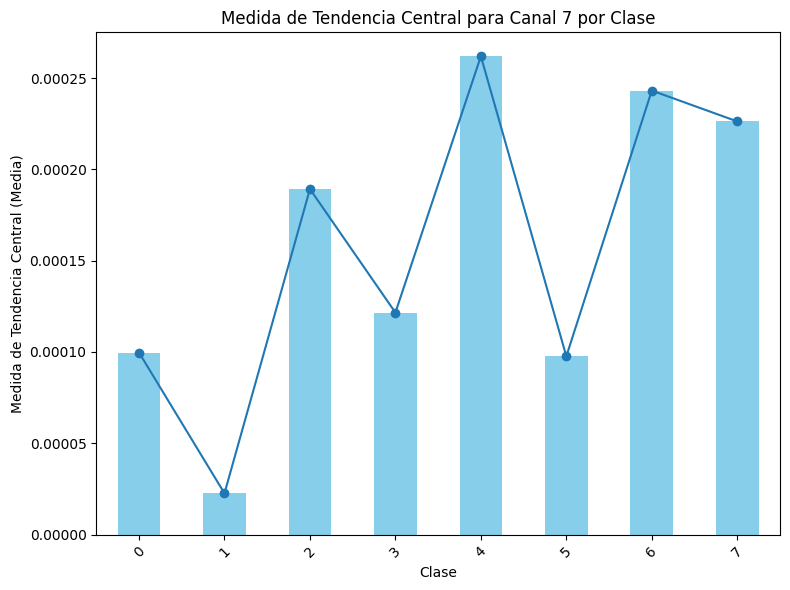

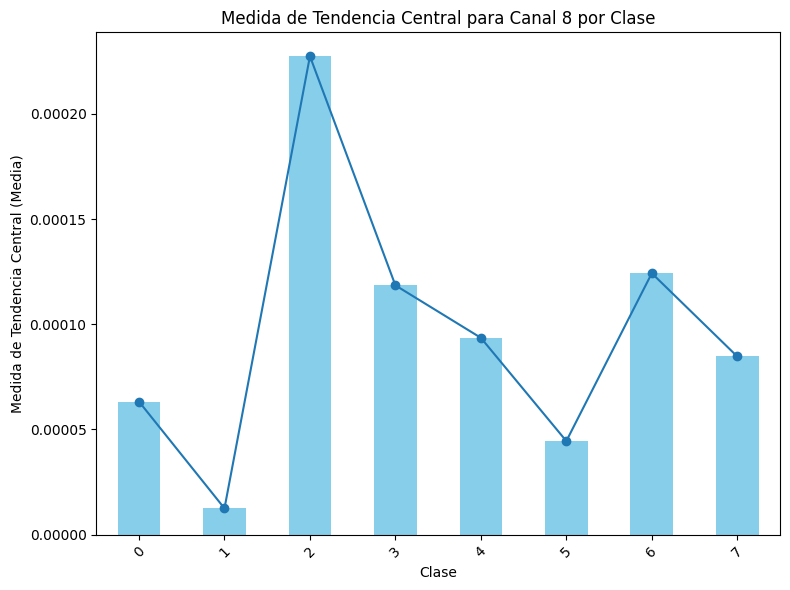

In [ ]:
def extract_rms_class(file_path):
    data = []
    #lee los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #salta la primera fila
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)
    data = np.array(data)

    #e los valores RMS de todos los canales y la clase
    rms_values = np.abs(data[:, :8])  #valores RMS de todos los canales
    class_values = data[:, -1].astype(int)  #gestos
    return rms_values, class_values

all_rms_values = {i: [] for i in range(1, 9)}  #lista para almacenar los valores RMS y clases de todos los sujetos para todos los canales
all_class_values = []

#itera sobre los diferentes sujetos y archivos
for sujeto_ejemplo in listas_sujetos:
    archivos_txt_ejemplo = glob.glob(os.path.join(sujeto_ejemplo, "2*.txt"))
    for archivo_ejemplo in archivos_txt_ejemplo:
        rms_values, class_values = extract_rms_class(archivo_ejemplo)
        for i, rms_channel_values in enumerate(rms_values.T, 1):
            all_rms_values[i].extend(rms_channel_values)
        all_class_values.extend(class_values)

#calcula la medida de tendencia central para cada clase y canal
central_measure = {}
for canal, data in all_rms_values.items():
    df = pd.DataFrame({'RMS': data, 'Class': all_class_values})
    central_measure[canal] = df.groupby('Class')['RMS'].mean()  #cambia mean por median si deseas mediana en lugar de media

# Grafica
for canal, central_measure_values in central_measure.items():
    plt.figure(figsize=(8, 6))
    central_measure_values.plot(kind='bar', color='skyblue')
    #bibuja la línea
    plt.plot(central_measure_values.index, central_measure_values.values, marker='o', linestyle='-')
    plt.title(f'Medida de Tendencia Central para Canal {canal} por Clase')
    plt.xlabel('Clase')
    plt.ylabel('Medida de Tendencia Central (Media)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

Los gráficos de la medida de la tendencia central bajo la curva del RMS, indica la información relacionada a la magnitud promedio de la señal EMG para cada gesto y evaluar la estabilidad de la señal.

En la grafica del canal 1 se puede observar que es la gráfica con menores fluctuaciones entre los gestos,  es decir que no hay muchas diferencias significativas en la magnitud promedio de la señal EMG entre los gestos.


**8. Prueba de Normalidad, Homocedasticidad y Prueba de Mann Whitney**
--

*Prueba de Normalidad*

In [ ]:
def extract_emg_features_by_gesture(data, gesture_labels): #extrae las características de señales EMG por cada gesto
    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)

    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask, :-1]  #obtener solo los datos de EMG, sin la última columna

        rms = np.sqrt(np.mean(gesture_data ** 2, axis=0))
        var = np.var(gesture_data, axis=0)
        mav = np.mean(np.abs(gesture_data), axis=0)
        mavs = np.sum(np.abs(gesture_data), axis=0)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)), axis=0)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)) > 0, axis=0)

        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))
    return emg_features_by_gesture

def test_normality_by_gesture_and_subject(listas_sujetos):
    subject_num = 1
    for subject_path in listas_sujetos:
        print(f"Sujeto {subject_num}:")
        archivos_txt_ejemplo = glob.glob(os.path.join(subject_path, "2*.txt"))
        for archivo_ejemplo in archivos_txt_ejemplo:
            data = [] #lee los datos del archivo
            with open(archivo_ejemplo, 'r') as file:
                next(file)  #saltar la primera fila (encabezados)
                for line in file:
                    values = [float(value) for value in line.strip().split('\t')]
                    data.append(values)
            data = np.array(data)

            #separar los datos por clase
            class_values = data[:, -1].astype(int)
            gesture_labels = class_values

            #extraer las características por gesto
            emg_features_by_gesture = extract_emg_features_by_gesture(data, gesture_labels)
            for gesture, features in emg_features_by_gesture.items():
                print(f"Gesto {gesture}:")
                for feature in ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC']:
                    feature_values = features[:, ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'].index(feature)]
                    kstest_stat, p_value = kstest(feature_values, 'norm')
                    if p_value > 0.05:
                        print(f"{feature}: Estadístico de Kolmogorov-Smirnov = {kstest_stat:.4f}, p-value = {p_value:.4f} -> Distribución Normal")
                    else:
                        print(f"{feature}: Estadístico de Kolmogorov-Smirnov = {kstest_stat:.4f}, p-value = {p_value:.4f} -> No Distribución Normal")
                print()
        subject_num += 1


test_normality_by_gesture_and_subject(listas_sujetos)

Sujeto 1:
Gesto 0:
RMS: Estadístico de Kolmogorov-Smirnov = 0.5000, p-value = 0.0132 -> No Distribución Normal
Varianza: Estadístico de Kolmogorov-Smirnov = 0.5000, p-value = 0.0132 -> No Distribución Normal
MAV: Estadístico de Kolmogorov-Smirnov = 0.5000, p-value = 0.0132 -> No Distribución Normal
MAVS: Estadístico de Kolmogorov-Smirnov = 0.9730, p-value = 0.0000 -> No Distribución Normal
SSC: Estadístico de Kolmogorov-Smirnov = 0.8889, p-value = 0.0000 -> No Distribución Normal
WL: Estadístico de Kolmogorov-Smirnov = 0.6004, p-value = 0.0012 -> No Distribución Normal
ZC: Estadístico de Kolmogorov-Smirnov = 0.8889, p-value = 0.0000 -> No Distribución Normal

Gesto 1:
RMS: Estadístico de Kolmogorov-Smirnov = 0.5000, p-value = 0.0132 -> No Distribución Normal
Varianza: Estadístico de Kolmogorov-Smirnov = 0.5000, p-value = 0.0132 -> No Distribución Normal
MAV: Estadístico de Kolmogorov-Smirnov = 0.5000, p-value = 0.0132 -> No Distribución Normal
MAVS: Estadístico de Kolmogorov-Smirnov = 

*Prueba de Homocedasticidad*

In [ ]:
def extract_emg_features_by_gesture(data, gesture_labels):
    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)

    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask, :-1]  #obtener solo los datos de EMG, sin la última columna

        rms = np.sqrt(np.mean(gesture_data ** 2, axis=0))
        var = np.var(gesture_data, axis=0)
        mav = np.mean(np.abs(gesture_data), axis=0)
        mavs = np.sum(np.abs(gesture_data), axis=0)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)), axis=0)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)) > 0, axis=0)

        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))

    return emg_features_by_gesture

def test_homogeneity_of_variance_by_gesture_and_subject(listas_sujetos):
    subject_num = 1
    for subject_path in listas_sujetos:
        print(f"Sujeto {subject_num}:")
        archivos_txt_ejemplo = glob.glob(os.path.join(subject_path, "2*.txt"))
        for archivo_ejemplo in archivos_txt_ejemplo:
            # Leer los datos del archivo
            data = []
            with open(archivo_ejemplo, 'r') as file:
                next(file)  #salta la primera fila (encabezados)
                for line in file:
                    values = [float(value) for value in line.strip().split('\t')]
                    data.append(values)
            data = np.array(data)

            #separar los datos por clase (osea gesto)
            class_values = data[:, -1].astype(int)
            gesture_labels = class_values

            #extraer las características por gesto
            emg_features_by_gesture = extract_emg_features_by_gesture(data, gesture_labels)
            for gesture, features in emg_features_by_gesture.items():
                print(f"Gesto {gesture}:")
                levene_stat, levene_p_value = levene(*[features[:, i] for i in range(features.shape[1])])
                if levene_p_value > 0.05:
                    print(f"Prueba de Levene: Estadístico = {levene_stat:.4f}, p-value = {levene_p_value:.4f} -> Homocedasticidad")
                else:
                    print(f"Prueba de Levene: Estadístico = {levene_stat:.4f}, p-value = {levene_p_value:.4f} -> No Homocedasticidad")
                print()
        subject_num += 1

test_homogeneity_of_variance_by_gesture_and_subject(listas_sujetos)

Sujeto 1:
Gesto 0:
Prueba de Levene: Estadístico = 0.9194, p-value = 0.4880 -> Homocedasticidad

Gesto 1:
Prueba de Levene: Estadístico = 0.9241, p-value = 0.4849 -> Homocedasticidad

Gesto 2:
Prueba de Levene: Estadístico = 0.9078, p-value = 0.4961 -> Homocedasticidad

Gesto 3:
Prueba de Levene: Estadístico = 0.8850, p-value = 0.5121 -> Homocedasticidad

Gesto 4:
Prueba de Levene: Estadístico = 0.8742, p-value = 0.5197 -> Homocedasticidad

Gesto 5:
Prueba de Levene: Estadístico = 0.8575, p-value = 0.5317 -> Homocedasticidad

Gesto 6:
Prueba de Levene: Estadístico = 0.8498, p-value = 0.5373 -> Homocedasticidad

Sujeto 2:
Gesto 0:
Prueba de Levene: Estadístico = 0.9201, p-value = 0.4876 -> Homocedasticidad

Gesto 1:
Prueba de Levene: Estadístico = 0.9206, p-value = 0.4872 -> Homocedasticidad

Gesto 2:
Prueba de Levene: Estadístico = 0.9114, p-value = 0.4936 -> Homocedasticidad

Gesto 3:
Prueba de Levene: Estadístico = 0.8853, p-value = 0.5119 -> Homocedasticidad

Gesto 4:
Prueba de Leve

*Prueba de Mann Whitney*

In [ ]:
def extract_emg_features_by_gesture(data, gesture_labels):

    emg_features_by_gesture = {}
    unique_gestures = np.unique(gesture_labels)
    for gesture in unique_gestures:
        gesture_mask = gesture_labels == gesture
        gesture_data = data[gesture_mask, :-1]  #obtener solo los datos de EMG, sin la última columna
        rms = np.sqrt(np.mean(gesture_data ** 2, axis=0))
        var = np.var(gesture_data, axis=0)
        mav = np.mean(np.abs(gesture_data), axis=0)
        mavs = np.sum(np.abs(gesture_data), axis=0)
        ssc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)), axis=0)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)) > 0, axis=0)
        emg_features_by_gesture[str(gesture)] = np.column_stack((rms, var, mav, mavs, ssc, wl, zc))
    return emg_features_by_gesture

def test_mann_whitney_by_gesture_and_subject(listas_sujetos):
    for subject_path_i, subject_path_j in zip(listas_sujetos[:-1], listas_sujetos[1:]):
        print(f"Comparando sujeto {listas_sujetos.index(subject_path_i) + 1} vs sujeto {listas_sujetos.index(subject_path_j) + 1}:")
        archivos_txt_ejemplo_i = glob.glob(os.path.join(subject_path_i, "2*.txt"))
        archivos_txt_ejemplo_j = glob.glob(os.path.join(subject_path_j, "2*.txt"))

        for archivo_ejemplo_i, archivo_ejemplo_j in zip(archivos_txt_ejemplo_i, archivos_txt_ejemplo_j):
            print(f"Comparando archivo {os.path.basename(archivo_ejemplo_i)} vs {os.path.basename(archivo_ejemplo_j)}")

            data_i = [] #leer los datos de los archivos
            with open(archivo_ejemplo_i, 'r') as file:
                next(file)  #saltar la primera fila (encabezados)
                for line in file:
                    values = [float(value) for value in line.strip().split('\t')]
                    data_i.append(values)
            data_i = np.array(data_i)

            data_j = []
            with open(archivo_ejemplo_j, 'r') as file:
                next(file)  #saltar la primera fila (encabezados)
                for line in file:
                    values = [float(value) for value in line.strip().split('\t')]
                    data_j.append(values)
            data_j = np.array(data_j)

            #separar los datos por clase
            class_values_i = data_i[:, -1].astype(int)
            class_values_j = data_j[:, -1].astype(int)
            gesture_labels_i = class_values_i
            gesture_labels_j = class_values_j

            #extraer las características por gesto
            emg_features_by_gesture_i = extract_emg_features_by_gesture(data_i, gesture_labels_i)
            emg_features_by_gesture_j = extract_emg_features_by_gesture(data_j, gesture_labels_j)

            unique_gestures_i = list(emg_features_by_gesture_i.keys())
            unique_gestures_j = list(emg_features_by_gesture_j.keys())

            for gesture in set(unique_gestures_i) & set(unique_gestures_j):
                print(f"Comparando Gesto {gesture} entre sujetos:")
                for feature in ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC']:
                    feature_index = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'].index(feature)
                    feature_values_i = emg_features_by_gesture_i[gesture][:, feature_index]
                    feature_values_j = emg_features_by_gesture_j[gesture][:, feature_index]
                    _, p_value = mannwhitneyu(feature_values_i, feature_values_j)
                    if p_value > 0.05:
                        print(f"{feature}: p-value = {p_value:.4f} -> No hay diferencia significativa")
                    else:
                        print(f"{feature}: p-value = {p_value:.4f} -> Hay diferencia significativa")
                print()

test_mann_whitney_by_gesture_and_subject(listas_sujetos)

Comparando sujeto 1 vs sujeto 2:
Comparando archivo 2_raw_data_13-13_22.03.16.txt vs 2_raw_data_14-21_22.03.16.txt
Comparando Gesto 6 entre sujetos:
RMS: p-value = 0.5365 -> No hay diferencia significativa
Varianza: p-value = 0.5365 -> No hay diferencia significativa
MAV: p-value = 0.5365 -> No hay diferencia significativa
MAVS: p-value = 0.3772 -> No hay diferencia significativa
SSC: p-value = 0.0070 -> Hay diferencia significativa
WL: p-value = 0.3772 -> No hay diferencia significativa
ZC: p-value = 0.0467 -> Hay diferencia significativa

Comparando Gesto 5 entre sujetos:
RMS: p-value = 0.3772 -> No hay diferencia significativa
Varianza: p-value = 0.3772 -> No hay diferencia significativa
MAV: p-value = 0.2893 -> No hay diferencia significativa
MAVS: p-value = 0.3772 -> No hay diferencia significativa
SSC: p-value = 0.0133 -> Hay diferencia significativa
WL: p-value = 0.4799 -> No hay diferencia significativa
ZC: p-value = 0.0118 -> Hay diferencia significativa

Comparando Gesto 3 en

**Correciones del informe**
--

**a. Hacer un breve resumen sobre la electromiografía y las características de esta señal**

La electromiografía es una técnica utilizada para evaluar e interpretar la actividad eléctrica de los músculos. Esta técnica permite obtener información detallada sobre la función muscular, proporcionando datos útiles para el diagnóstico y seguimiento de diversas enfermedades neuromusculares.

Las características de la señal EMG
Es una señal bipolar con una distribución simétrica de amplitudes positivas y negativas (el valor medio es igual a cero) [1]
Los picos de EMG sin procesar tienen forma aleatoria [1].
El rango de amplitud de una señal EMG es de 0 a 10 mV antes de la amplificación [2].
La amplitud tiene el potencial de proporcionar una medida de la magnitud de la fuerza muscular, pero esta relación se complica tanto por el carácter del EMG medido como por la mecánica muscular [3].
Normalmente, la frecuencia de una señal EMG oscila entre 6 y 500 Hz, mostrando la mayor potencia de frecuencia entre 20 y 250 Hz [1].
Una señal EMG está influenciada por la velocidad de disparo de las unidades motoras, que, en la mayoría de las condiciones, disparan en la región de frecuencia de 0 a 20 Hz [2].

**b. Hacer una breve descripción del operador de TKEO, que información entrega y como se interpreta con los datos entregados**

El Teager-Kaiser Energy operator, es una herramienta usada en el procesamiento de señales digitales que encuentra la energía instantánea de una señal multiplicando su segundo orden derivativo. El operador TeagerKaiser Energy permitirá detectar rápidos cambios de energía en una señal, y por lo tanto, se puede usar para extraer características útiles de un análisis. [4]

El resultado de la TKEO nos dará una estimación de la energía instantánea de la señal en cada punto en el tiempo en donde el operador TKEO tendrá la tendencia de aumentar la respuesta a frecuencias altas impulsos, es por esto que en el caso especifico de las señales EMG, puede interpretar o ayudar a identificar contracciones musculares rápidas.

**c. Discusión de las diferencias en los grupos usando las gráficas obtenidas. Seleccione el tipo de representación que mejor le permita describir la información**

El gráfico de caja muestra la distribución de la suma de cuadrados residuales (SSQ) promedio por canal para cada gesto, cada caja representa la distribución de la SSQ promedio para una gesto específica para todos los sujetos, las líneas horizontales dentro de las cajas representan la mediana, mientras que los bordes de las cajas representan el primer y tercer cuartil, los bigotes representan los valores máximo y mínimo dentro del rango intercuartil (IQR) y los puntos fuera de los bigotes se consideran valores diferentes, se puede decir que la distribución de la SSQ promedio por canal parece ser no normal para todas las gestos, esto se debe a que realizamos diferentes acciones en cada gesto que varian mucho entre si, el potencial y los niveles de contraccion muscular cambia respecto a cada movimiento o gesto que se realice y con este tipo de analisis podemos confirmarlo.

**d. Planteamiento de las hipótesis nulas y alternativas, selección del tipo de prueba (paramétrica o no paramétrica) y discusión de los resultados**

Las pruebas de hipótesis nos permiten evaluar si existe evidencia suficiente para rechazar o no una hipótesis nula (H0). El valor p (p-value) indica la probabilidad de obtener los resultados observados, suponiendo que la hipótesis nula es verdadera. Para comenzar dichas pruebas, debemos verificar varios supuestos.

Primero, después de realizar el manejo y análisis de los datos, es necesario corroborar la independencia de las observaciones. En este caso, se confirmó al tener datos de 36 sujetos diferentes y dos series de tomas, según los parámetros del proyecto.

*Respecto a la prueba de Normalidad*

H0: La distribución de las caracteristicas de cada gesto del sujeto (analizando el comportamiento de  sus canales para cada gesto) es normal
H1: La distribución de las caracteristicas de cada gesto del sujeto (analizando el comportamiento de  sus canales para cada gesto) NO es normal

Todos los resultados indican que las características extraídas no siguen una distribución normal para ninguno de los gestos y sujetos analizados, el test de Kolmogorov-Smirnov muestra p-valores menores a 0.05 para todas las características, lo que lleva a rechazar la hipótesis nula de normalidad. esto sugiere que las señales de EMG y las características derivadas de ellas no se ajustan a una distribución normal, lo cual es importante considerar al momento de aplicar técnicas estadísticas, existe una variabilidad considerable tanto entre los diferentes sujetos como entre los distintos gestos realizados, lo cual es un aspecto importante a tener en cuenta en el análisis de señales de EMG, la falta de normalidad en las características extraídas puede deberse a diferencias anatómicas entre sujetos o varianza de los patrones de activación muscular involucrados en la realización de los diversos gestos

*Respecto a la prueba de homocedasticidad*

Para todos los sujetos y sus los gestos, los resultados de la prueba de Levene muestran p-valores superiores a 0.05, esto indica que no se puede rechazar la hipótesis nula de homogeneidad de varianza (homocedasticidad) entre las características extraídas (RMS, Varianza, MAV, MAVS, SSC, WL, ZC) para cada gesto. Osea que las varianzas de estas características son estadísticamente iguales dentro de cada gesto, lo que implica que cumplen con el supuesto de homocedasticidad



Debido a que no se cumplieron todos los supuestos necesarios para realizar pruebas paramétricas, se optó por una prueba no paramétrica de Mann-Whitney, que permite analizar datos en escala nominal utilizando observaciones independientes.

*Respecto a la prueba de Mann Whitney*

Realizando la prueba comparando de a 2 sujetos y sus gestos, las hipotesis serian

H0: Las distribuciones de los datos de gestos iguales comparados en distintos sujetos son diferentes                         
H1: Las distribuciones de los datos de gestos iguales comparados en distintos sujetos son iguales

El código realiza una comparación de las características extraídas de las señales EMG (RMS, Varianza, MAV, MAVS, etc..) entre los diferentes gestos y entre los diferentes sujetos, esto permite identificar si existen diferencias significativas en las características EMG, en los resultados mostrados se puede ver que para la gran mayoria de gestos y características, no hay diferencias significativas entre los sujetos (aunque para algunos pocos muy especificios si hay diferencias significativas) estos resultados indicarian que la gran mayoria de caracteristicas de las señales EMG son más consistentes entre sujetos cuando comparamos estos datos entre gestos iguales, aunque algunos pocos presentan una variabilidad

Estos resultados tienen sentido, ya que, si bien las señales EMG asociadas a un mismo gesto motriz tienden a compartir patrones comunes entre diferentes personas, cada individuo también puede presentar pequeñas particularidades en la ejecución de los movimientos que se reflejan en diferencias sutiles en las características de la señal. Esto resalta la importancia de considerar tanto los aspectos comunes como la variabilidad individual al desarrollar sistemas de reconocimiento de gestos basados en EMG.

**CONCLUSIONES**
--

* Se observa que la aplicación del operador TKEO tiene un impacto significativo en las características de la señal EMG. Las características como la RMS, varianza, valor absoluto medio, pendiente del valor absoluto medio, cambios de signo de la pendiente, longitud de la forma de onda y cruces por cero pueden mostrar diferencias cuantificables entre las señales con y sin TKEO.

* Los resultados sugieren que el operador TKEO puede ser útil para mejorar la detección de características relevantes en las señales EMG. Por ejemplo, puede ayudar a resaltar ciertas características que de otro modo serían difíciles de identificar

* Los datos no siguen una distribución normal respecto a gestos, lo cual es una respuesta esperada debido a el cambio de activacion buscular que sufren los sujetos, se cumple el supuesto de homocedasticidad (igualdad de varianzas) para el analisis de gestos iguales para distintos sujetos. Estos resultados sugieren que, debido a la falta del supuesto de normalidad, sería más apropiado utilizar pruebas no paramétricas para analizar los datos EMG en lugar de pruebas paramétricas, como lo es la pruena de Mann Whitney

* De los resultados presentados, se puede concluir que, en general, las señales EMG asociadas a gestos similares tienden a mostrar consistencia en sus características entre diferentes sujetos, sin embargo, la presencia de algunas diferencias significativas en características específicas sugiere que existe variabilidad individual en la ejecución de los movimientos, lo que se refleja en sutiles variaciones en las señales EMG, esta variabilidad individual puede deberse a factores como la anatomía muscular, la técnica de ejecución o la activación neuromuscular única de cada individuo.